# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [9]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined

In [10]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [11]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [12]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [14]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [15]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [16]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.367112565636635, discriminator loss: 0.25991313907690344


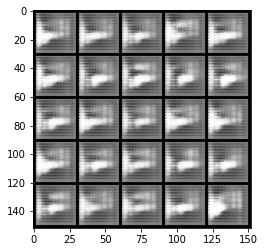

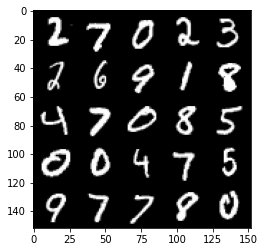

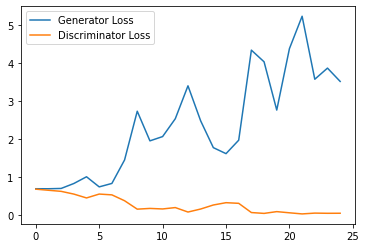

Step 1000: Generator loss: 4.115775698900223, discriminator loss: 0.08571291476860643


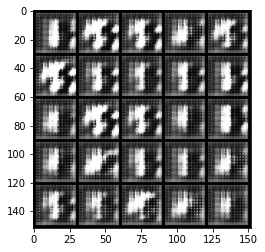

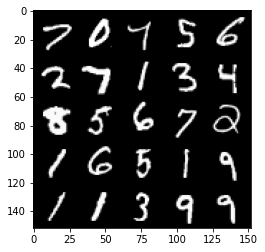

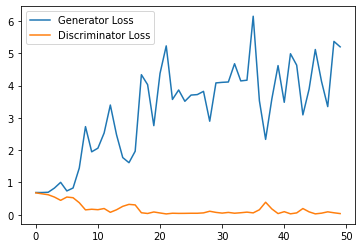

Step 1500: Generator loss: 3.703971230506897, discriminator loss: 0.10445816624909639


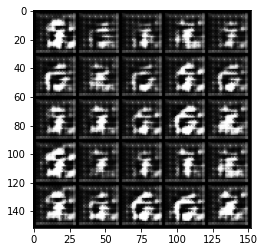

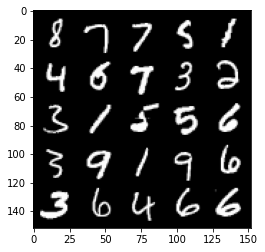

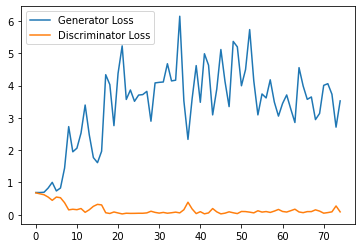

Step 2000: Generator loss: 3.0936694009304047, discriminator loss: 0.16838028368353844


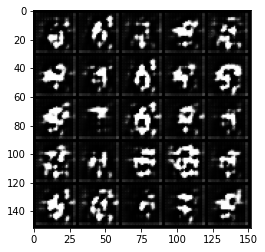

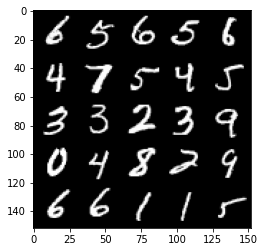

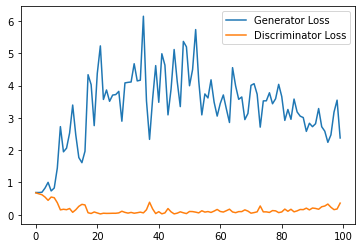

Step 2500: Generator loss: 2.15797798037529, discriminator loss: 0.30479908612370493


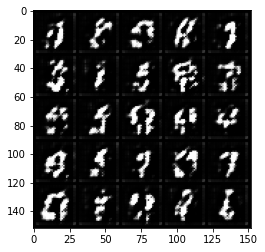

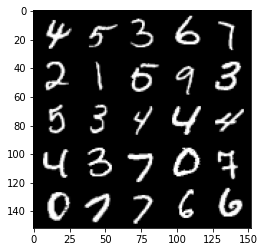

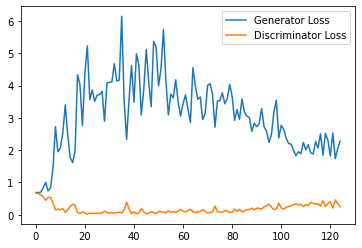

Step 3000: Generator loss: 1.9065912685394286, discriminator loss: 0.38783810889720916


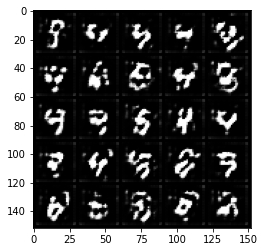

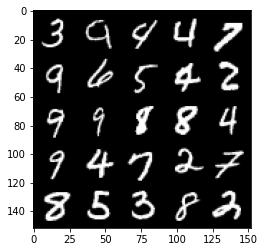

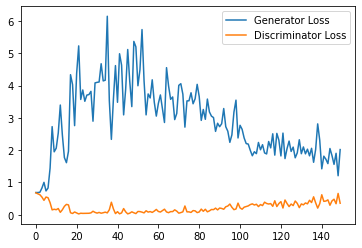

Step 3500: Generator loss: 1.809357750892639, discriminator loss: 0.3941578281223774


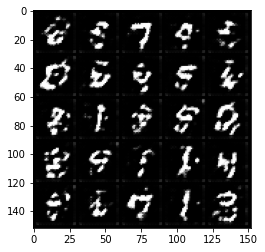

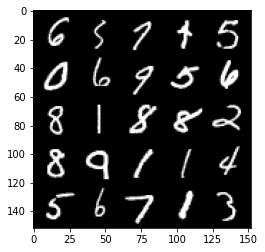

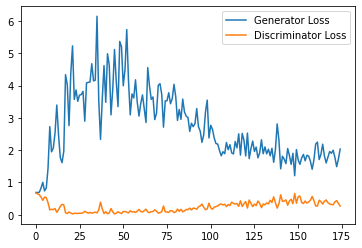

Step 4000: Generator loss: 1.9712151169776917, discriminator loss: 0.366966175198555


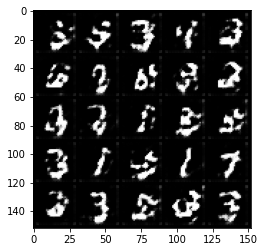

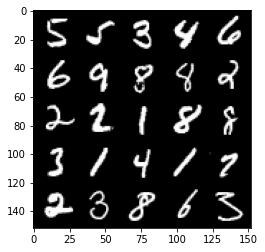

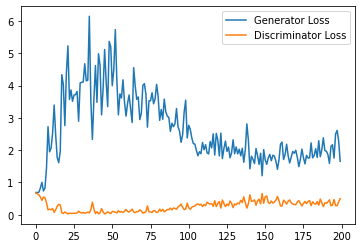

Step 4500: Generator loss: 1.9265019054412842, discriminator loss: 0.3570835255384445


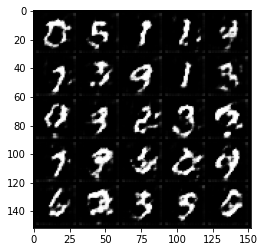

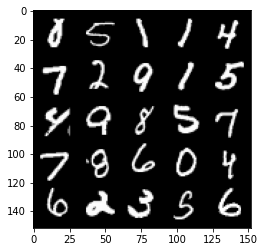

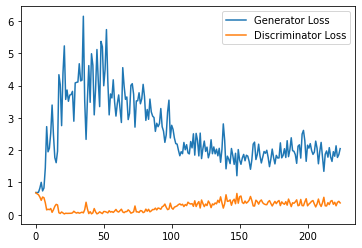

Step 5000: Generator loss: 1.7989734122753143, discriminator loss: 0.37976522931456563


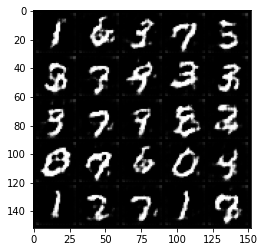

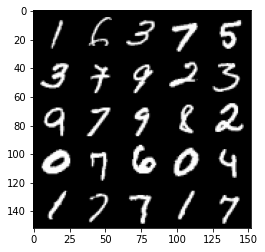

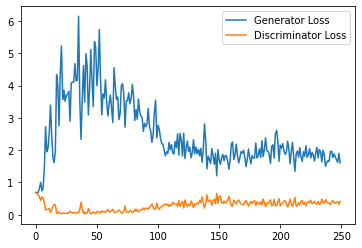

Step 5500: Generator loss: 1.7310182876586915, discriminator loss: 0.3728338118195534


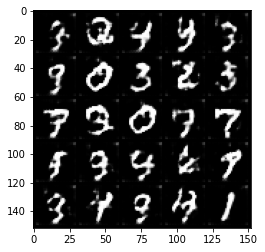

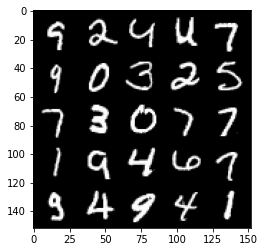

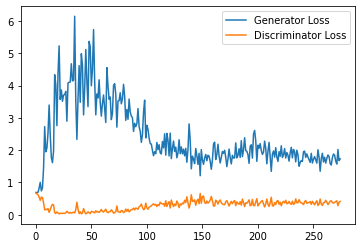

Step 6000: Generator loss: 1.7215598151683806, discriminator loss: 0.40224806901812554


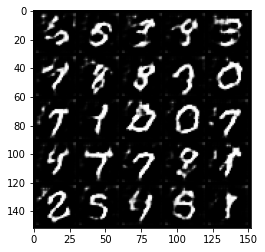

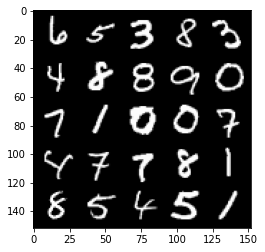

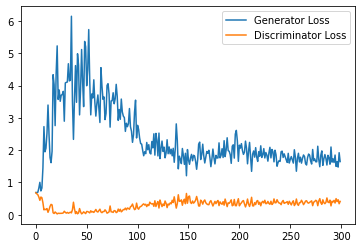

Step 6500: Generator loss: 1.6237809736728668, discriminator loss: 0.41781535333395003


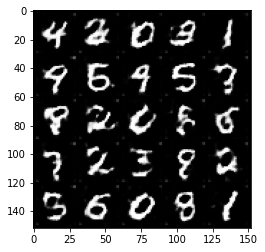

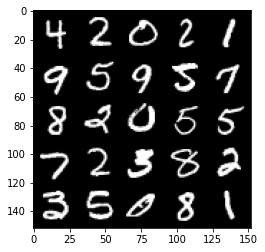

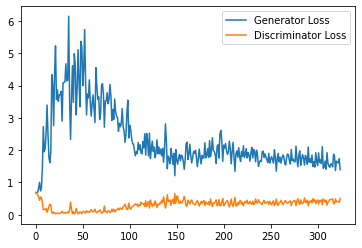

Step 7000: Generator loss: 1.5938485300540923, discriminator loss: 0.4415570601224899


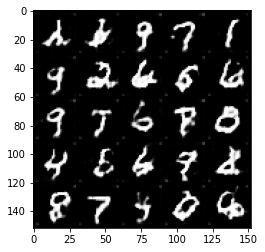

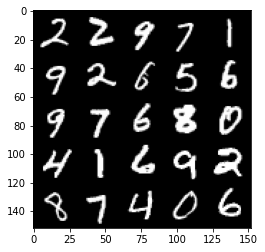

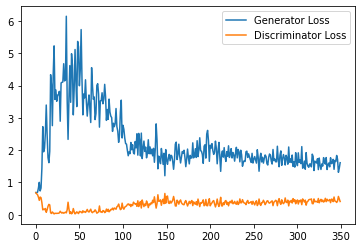

Step 7500: Generator loss: 1.5134701731204987, discriminator loss: 0.4463299512863159


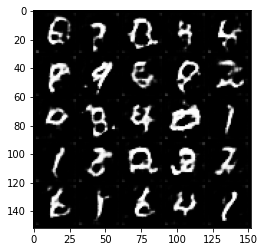

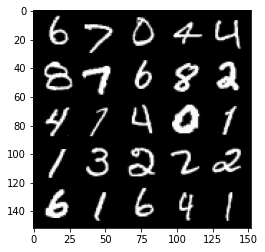

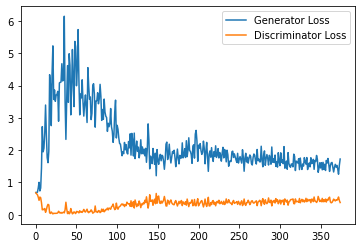

Step 8000: Generator loss: 1.441756353497505, discriminator loss: 0.47592850896716116


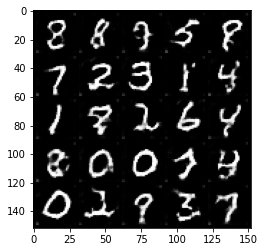

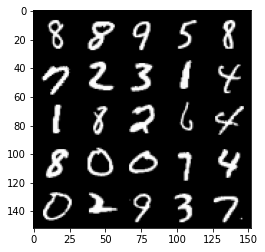

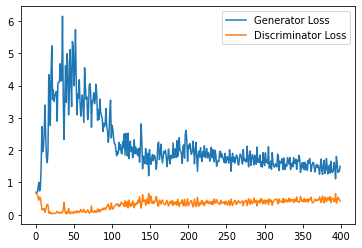

Step 8500: Generator loss: 1.4478019353151321, discriminator loss: 0.4956305140852928


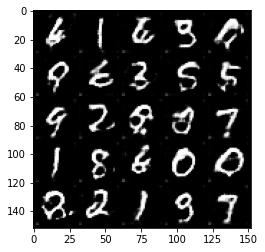

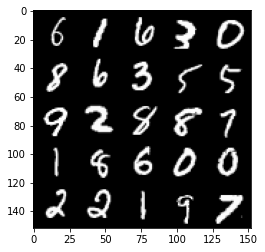

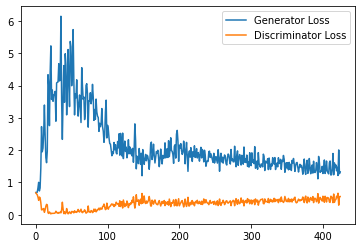

Step 9000: Generator loss: 1.2952853566408158, discriminator loss: 0.5025193846225738


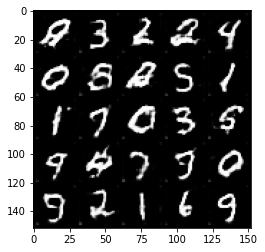

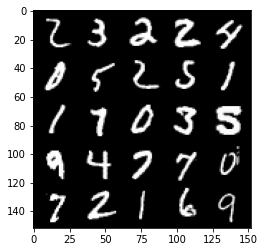

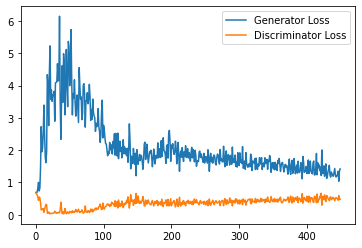

Step 9500: Generator loss: 1.295385672569275, discriminator loss: 0.5231775420308113


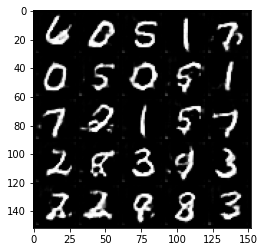

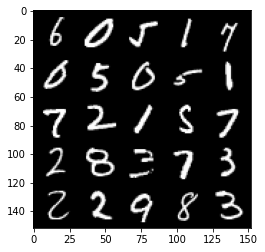

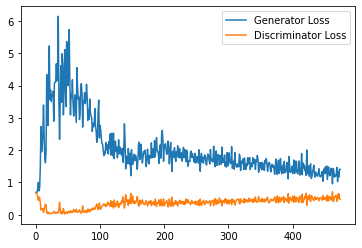

Step 10000: Generator loss: 1.2503264020681382, discriminator loss: 0.5407768784165382


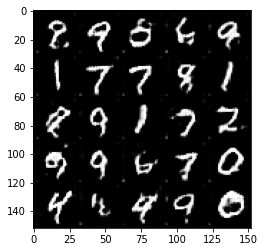

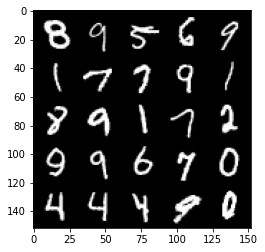

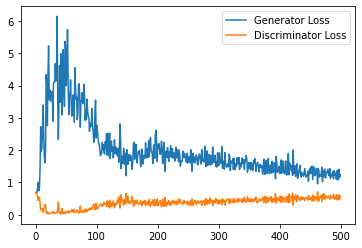

Step 10500: Generator loss: 1.1822445747852326, discriminator loss: 0.5358098351955414


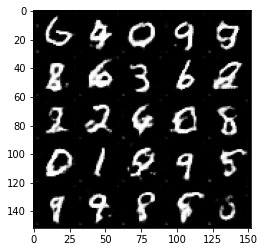

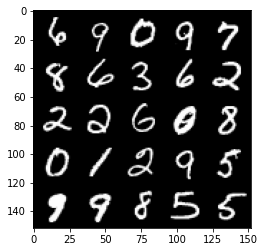

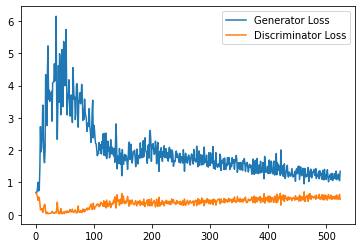

Step 11000: Generator loss: 1.1918284984827041, discriminator loss: 0.5542268162965774


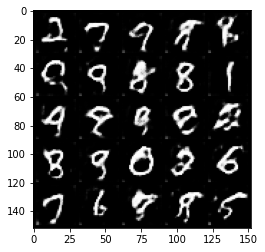

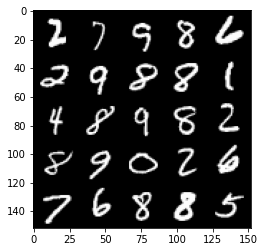

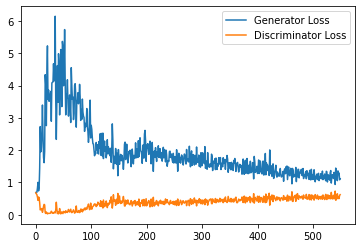

Step 11500: Generator loss: 1.201062264084816, discriminator loss: 0.5575546740889549


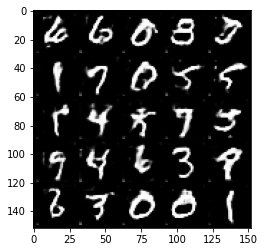

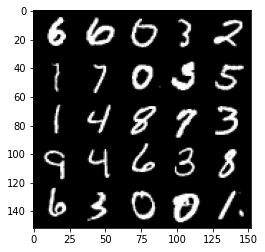

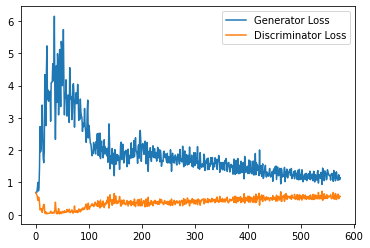

Step 12000: Generator loss: 1.113688681602478, discriminator loss: 0.568095429778099


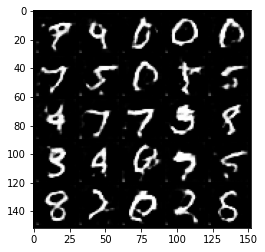

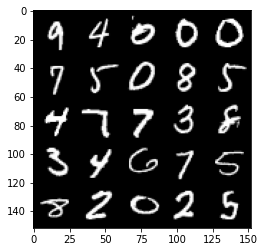

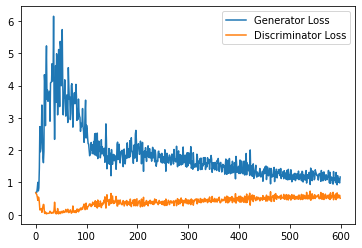

Step 12500: Generator loss: 1.1105913321971894, discriminator loss: 0.5752904928326606


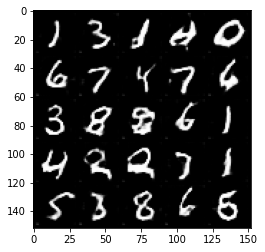

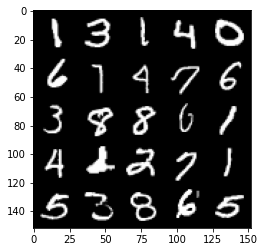

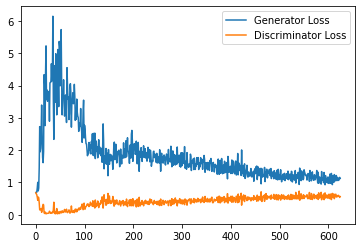

Step 13000: Generator loss: 1.1225161138772966, discriminator loss: 0.5788453769683838


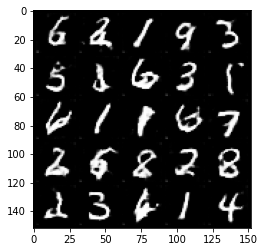

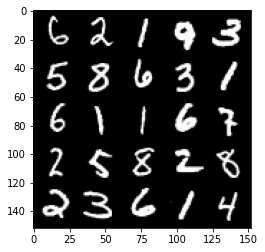

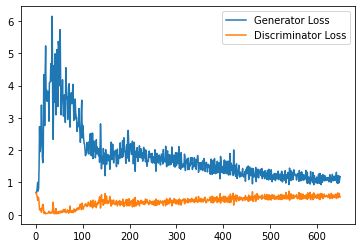

Step 13500: Generator loss: 1.065573131084442, discriminator loss: 0.5828834006786346


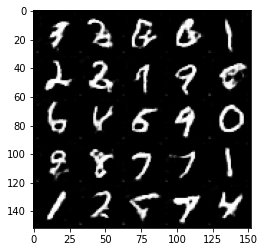

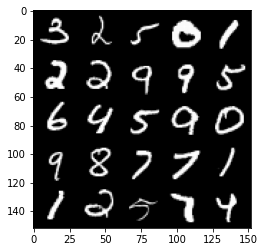

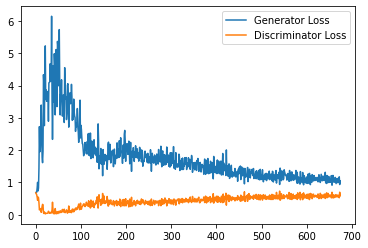

Step 14000: Generator loss: 1.0668599135875703, discriminator loss: 0.5884397324323655


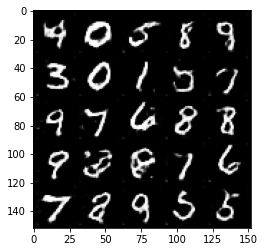

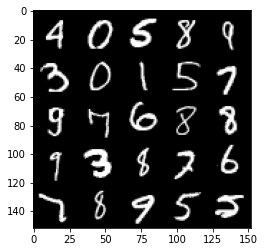

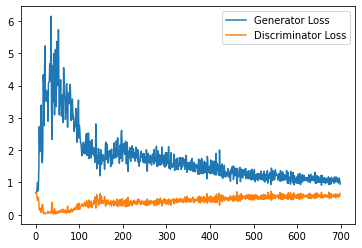

Step 14500: Generator loss: 1.0439785376787185, discriminator loss: 0.5937425866127014


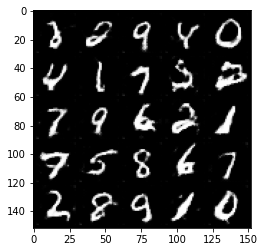

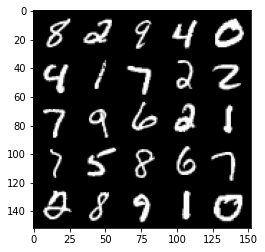

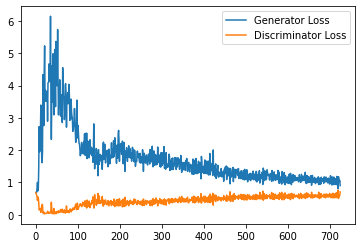

Step 15000: Generator loss: 1.05483802485466, discriminator loss: 0.6002526769638061


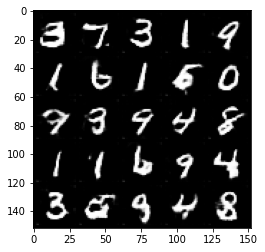

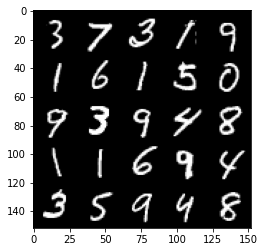

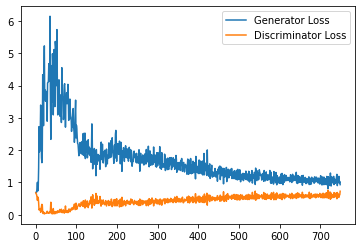

Step 15500: Generator loss: 1.0599812182188033, discriminator loss: 0.5937330938577652


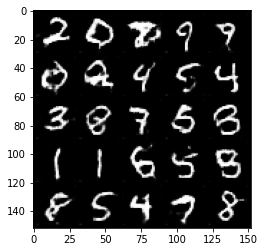

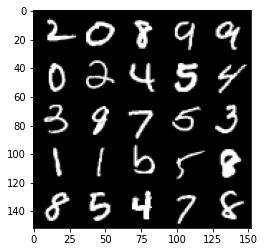

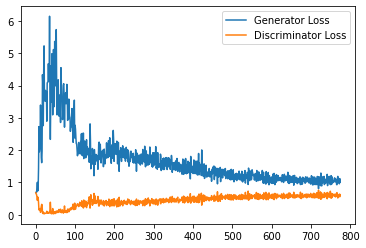

Step 16000: Generator loss: 1.0077287032604219, discriminator loss: 0.6054168756604195


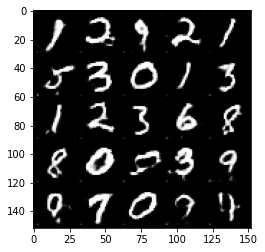

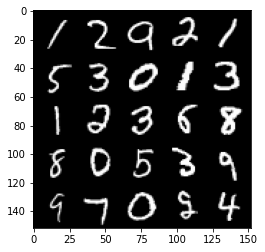

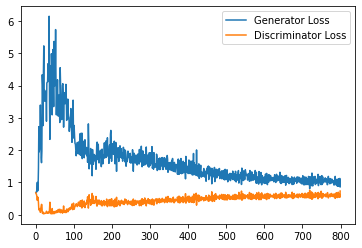

Step 16500: Generator loss: 1.0073295811414718, discriminator loss: 0.5982708804011345


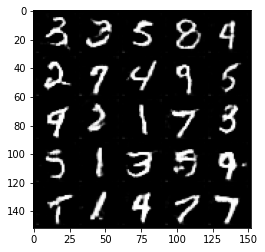

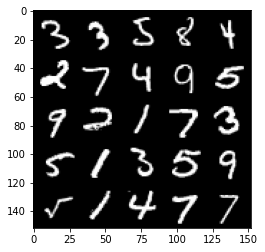

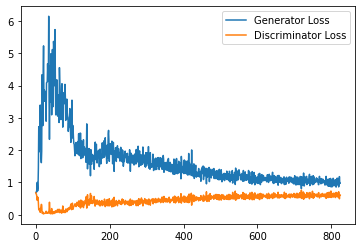

Step 17000: Generator loss: 0.9993355543613434, discriminator loss: 0.6039656085371972


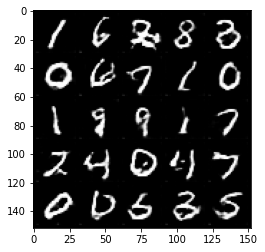

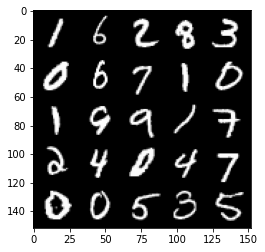

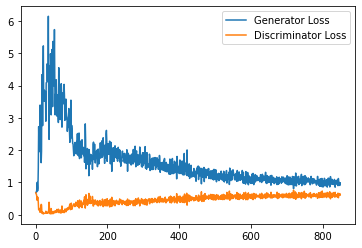

Step 17500: Generator loss: 0.9962413439750671, discriminator loss: 0.6046954225301743


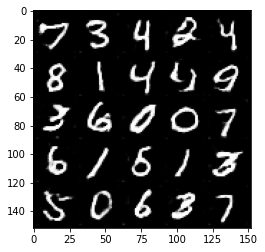

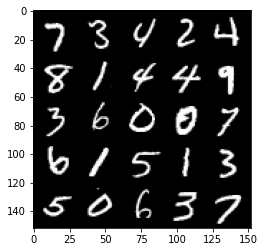

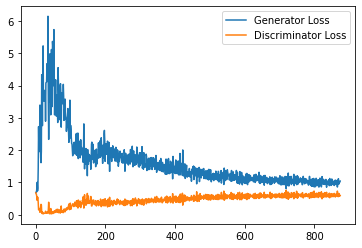

Step 18000: Generator loss: 1.0135621222257614, discriminator loss: 0.6081655994057655


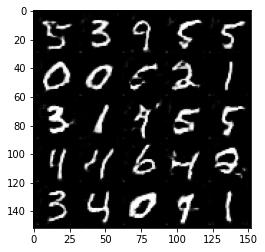

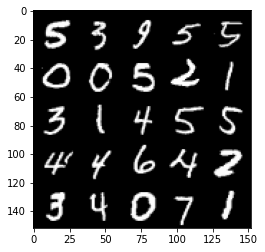

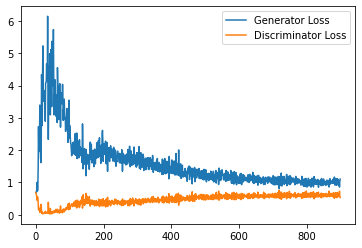

Step 18500: Generator loss: 0.9825871913433075, discriminator loss: 0.6013886583447456


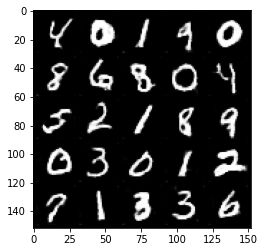

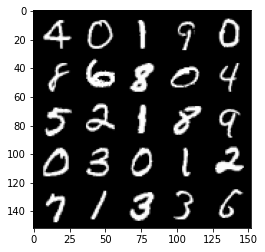

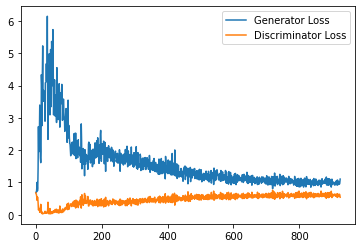

Step 19000: Generator loss: 1.0161176809072494, discriminator loss: 0.6110364964604378


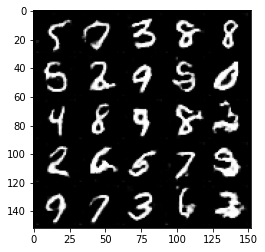

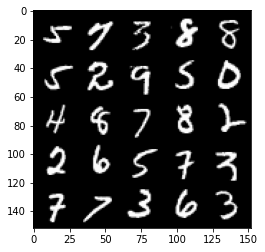

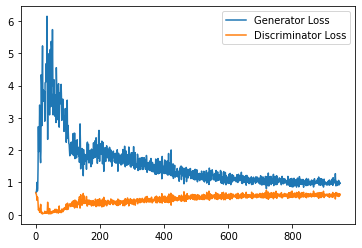

Step 19500: Generator loss: 0.9644845715761184, discriminator loss: 0.6074369151592255


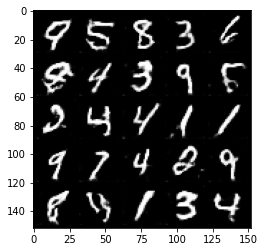

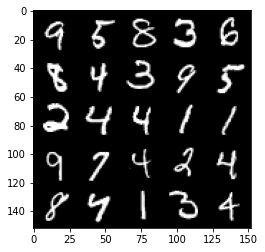

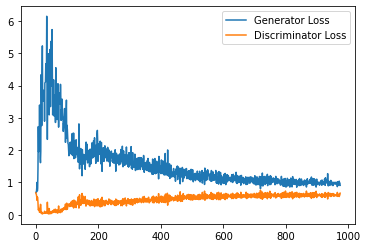

Step 20000: Generator loss: 0.9733199738264083, discriminator loss: 0.6097769667506218


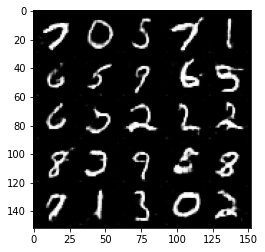

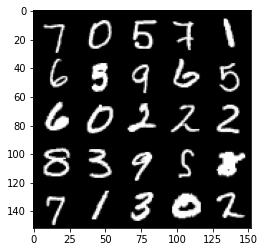

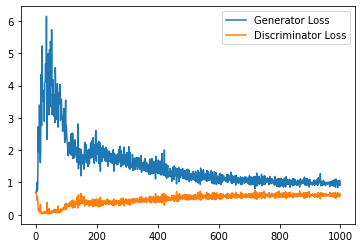

Step 20500: Generator loss: 0.986711806178093, discriminator loss: 0.6051598988771438


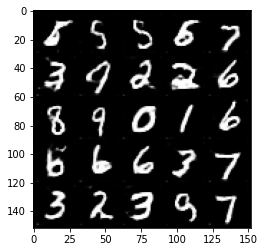

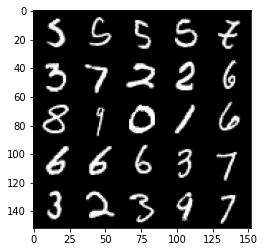

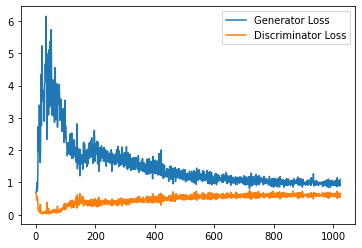

Step 21000: Generator loss: 0.9532565488815308, discriminator loss: 0.6173538880944252


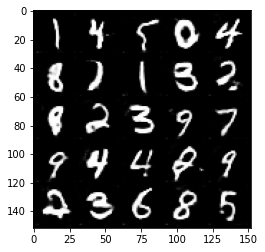

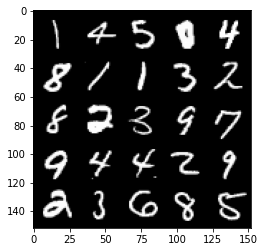

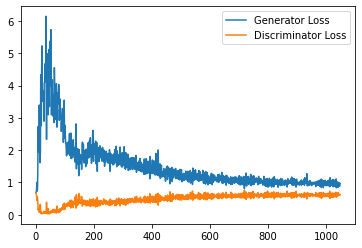

Step 21500: Generator loss: 0.9954886519908905, discriminator loss: 0.6139323733448983


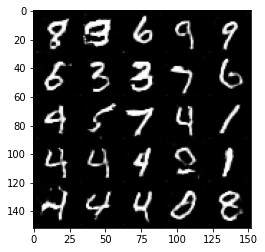

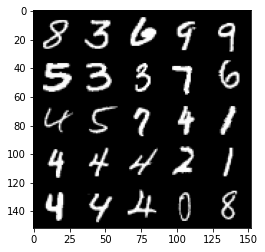

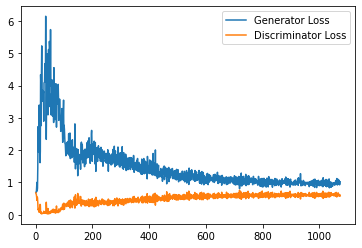

Step 22000: Generator loss: 0.971563170671463, discriminator loss: 0.6209235247969628


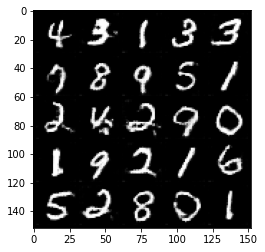

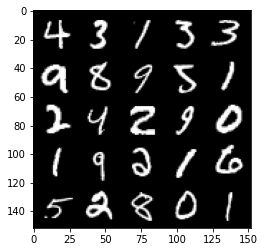

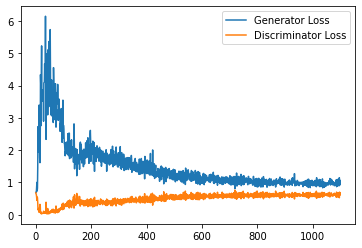

Step 22500: Generator loss: 0.9694015164375305, discriminator loss: 0.6121837537288666


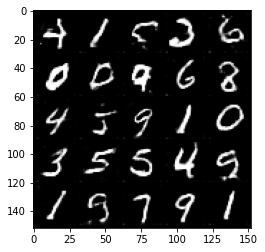

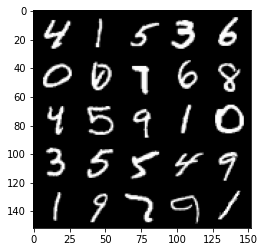

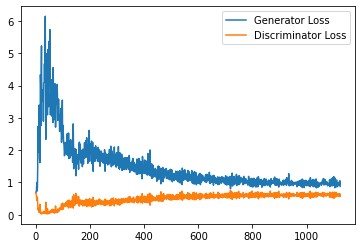

Step 23000: Generator loss: 0.9346688953638077, discriminator loss: 0.6207902126312256


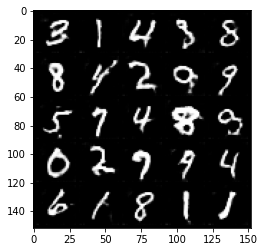

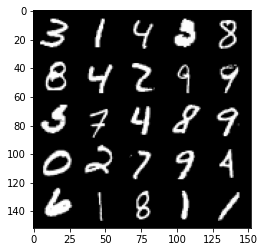

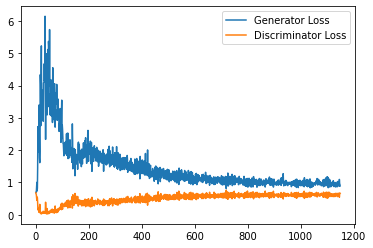

Step 23500: Generator loss: 0.9597517949342728, discriminator loss: 0.615483285844326


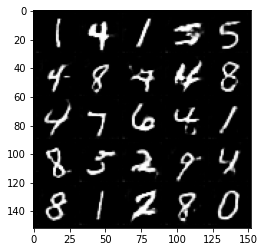

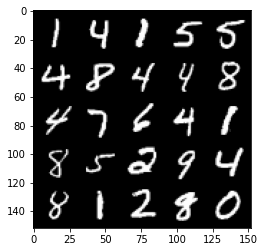

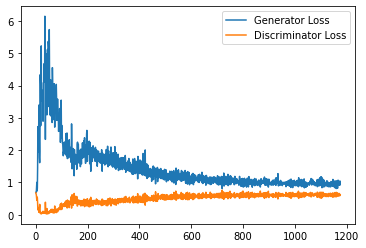

Step 24000: Generator loss: 0.948682980298996, discriminator loss: 0.624063408613205


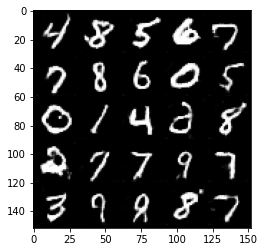

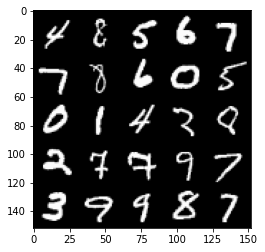

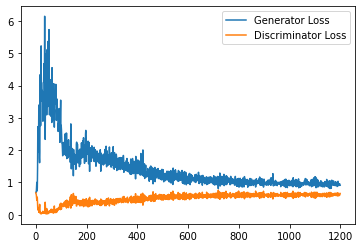

Step 24500: Generator loss: 0.9467505849599839, discriminator loss: 0.6163565112948418


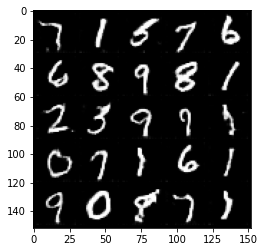

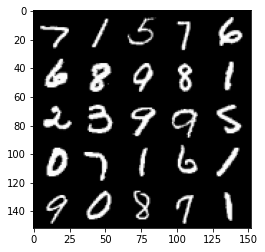

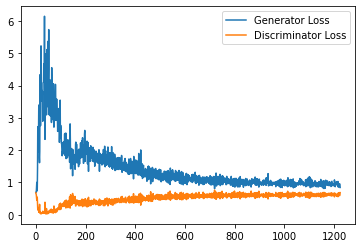

Step 25000: Generator loss: 0.9386603926420212, discriminator loss: 0.6183006509542465


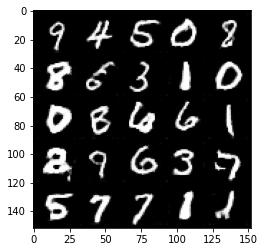

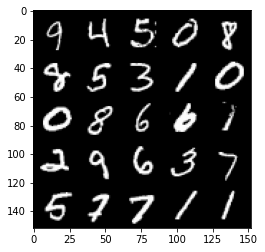

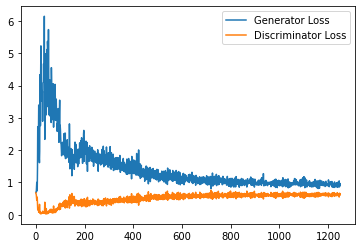

Step 25500: Generator loss: 0.9353666106462478, discriminator loss: 0.6226315566897392


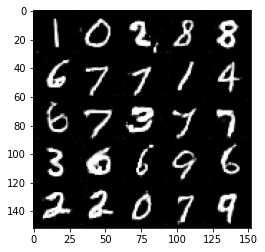

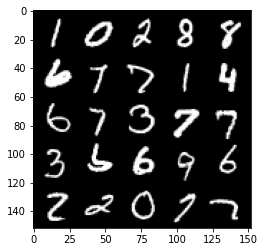

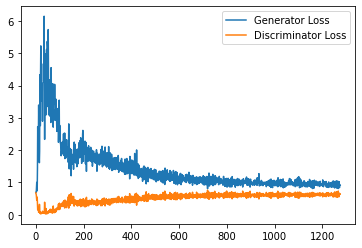

Step 26000: Generator loss: 0.9544883499145508, discriminator loss: 0.6179954848885536


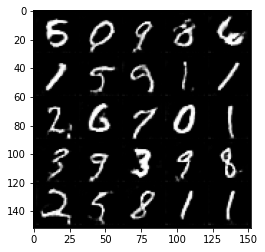

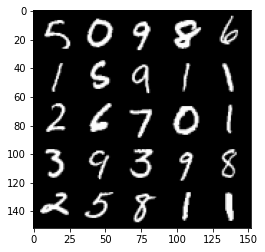

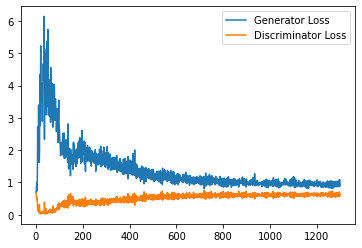

Step 26500: Generator loss: 0.9570675711631775, discriminator loss: 0.6217098156809807


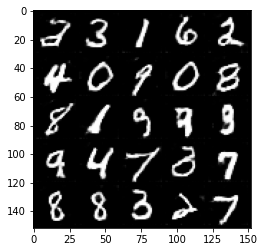

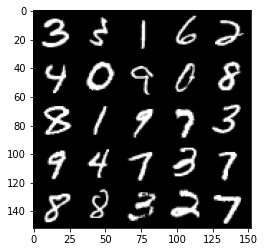

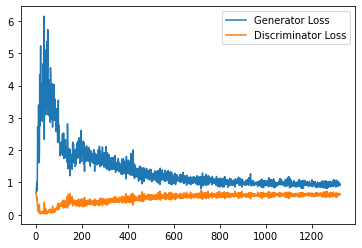

Step 27000: Generator loss: 0.9071803827285767, discriminator loss: 0.6229739526510238


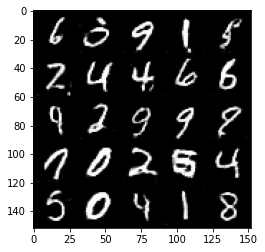

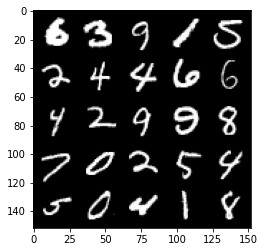

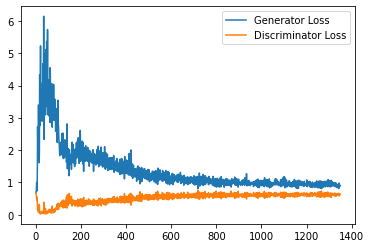

Step 27500: Generator loss: 0.9182120879888535, discriminator loss: 0.6232718217968941


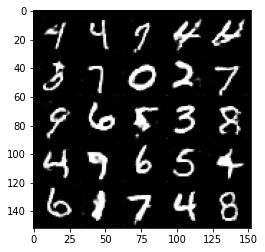

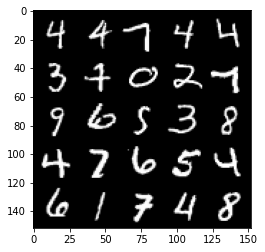

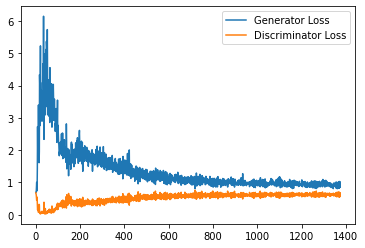

Step 28000: Generator loss: 0.9063854211568833, discriminator loss: 0.6218343274593353


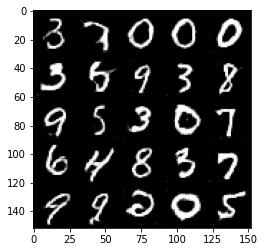

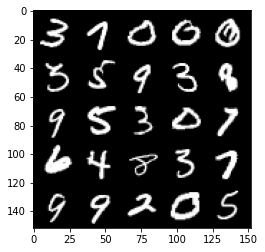

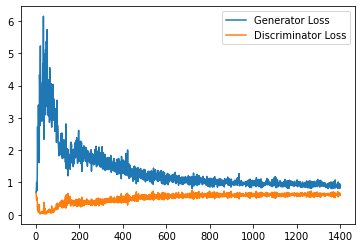

Step 28500: Generator loss: 0.9214229469299317, discriminator loss: 0.622375431060791


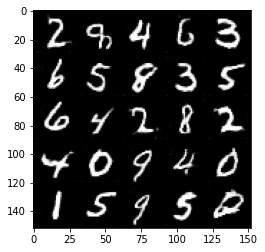

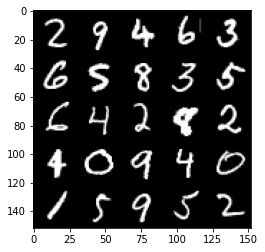

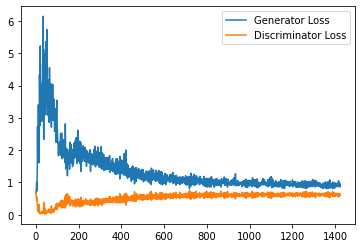

Step 29000: Generator loss: 0.9291850131750107, discriminator loss: 0.6265712985992432


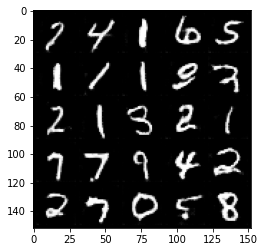

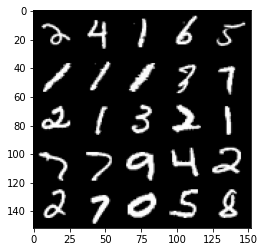

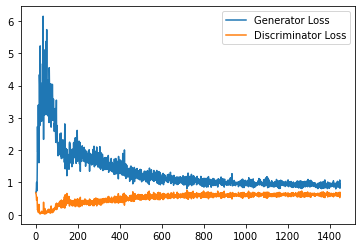

Step 29500: Generator loss: 0.9235058740377426, discriminator loss: 0.6276000131368638


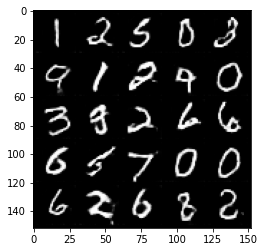

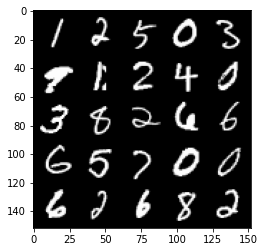

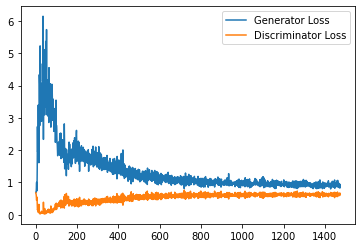

Step 30000: Generator loss: 0.9100384104251862, discriminator loss: 0.6252767448425293


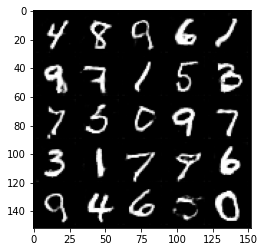

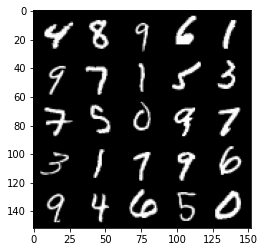

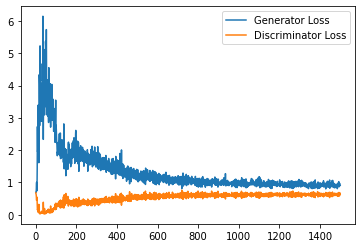

Step 30500: Generator loss: 0.9150632582902908, discriminator loss: 0.6236608464717865


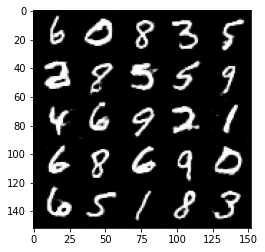

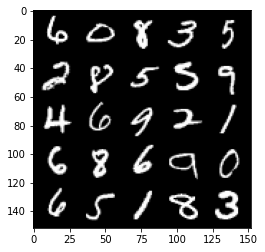

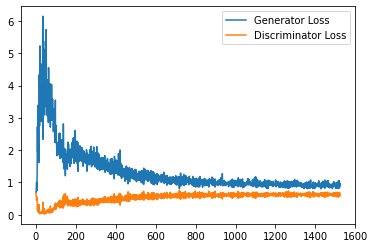

Step 31000: Generator loss: 0.9272607154846192, discriminator loss: 0.6204921658039093


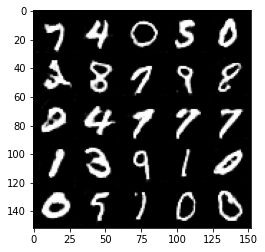

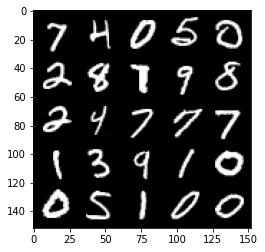

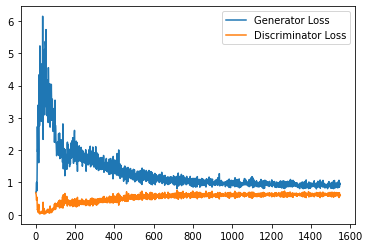

Step 31500: Generator loss: 0.9144487806558609, discriminator loss: 0.6238541033267975


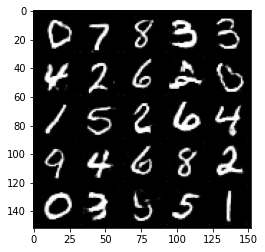

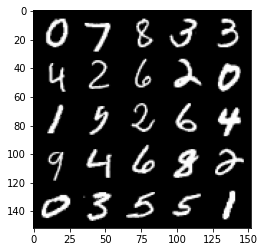

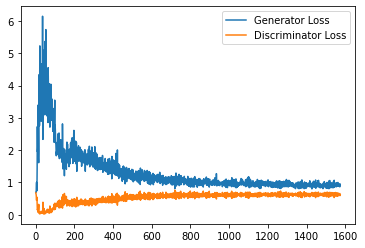

Step 32000: Generator loss: 0.9219293694496155, discriminator loss: 0.6268797991275787


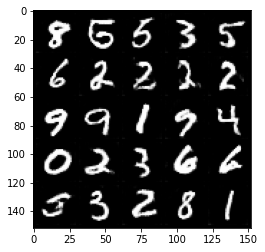

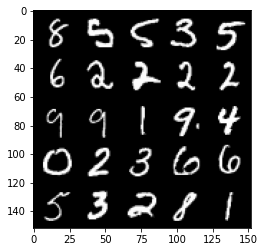

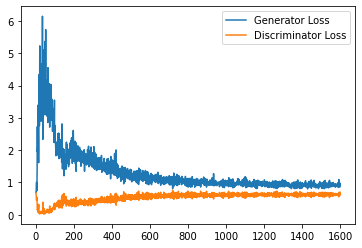

Step 32500: Generator loss: 0.9107493717670441, discriminator loss: 0.6221939201951027


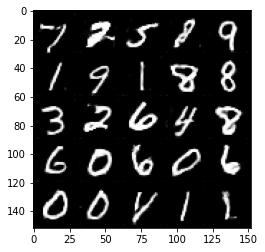

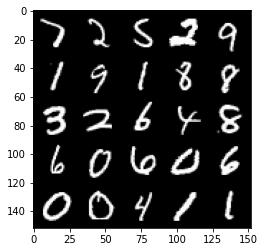

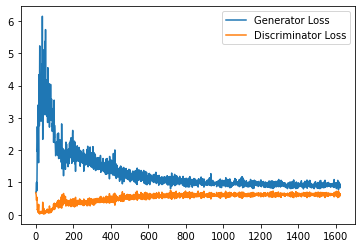

Step 33000: Generator loss: 0.893758126616478, discriminator loss: 0.6245258476734161


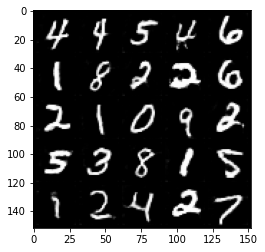

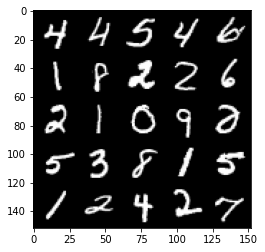

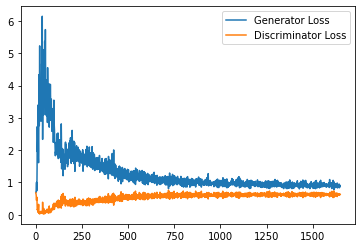

Step 33500: Generator loss: 0.8937273918390274, discriminator loss: 0.6254734091758728


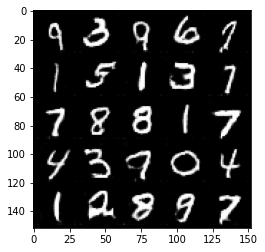

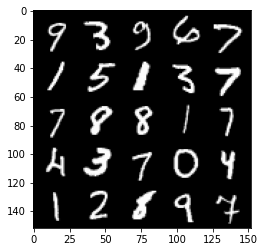

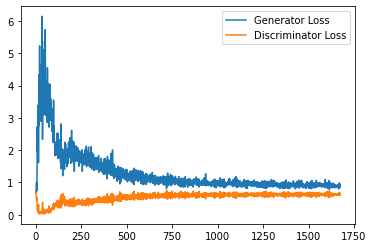

Step 34000: Generator loss: 0.918392082810402, discriminator loss: 0.6228756555318833


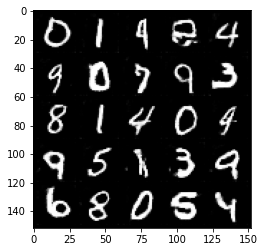

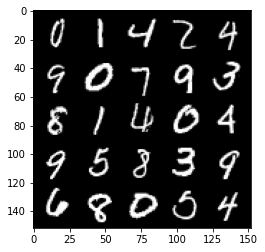

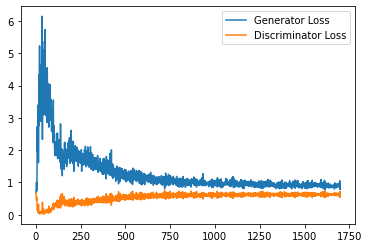

Step 34500: Generator loss: 0.9240011579990387, discriminator loss: 0.6266278458833694


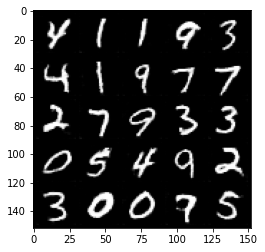

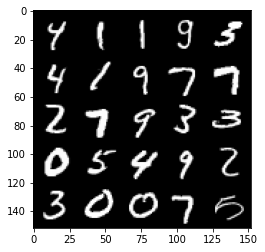

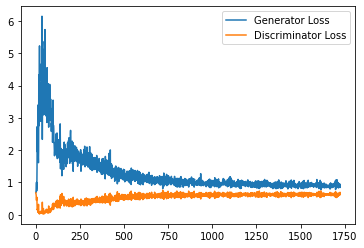

Step 35000: Generator loss: 0.915501046538353, discriminator loss: 0.6229940779209137


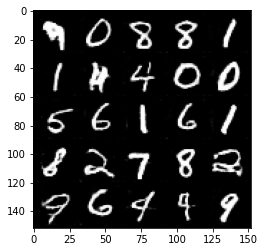

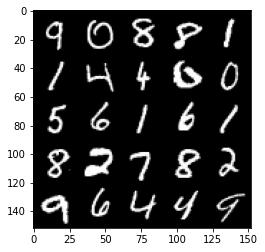

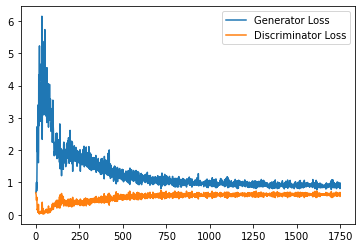

Step 35500: Generator loss: 0.9074701865911484, discriminator loss: 0.6253412820696831


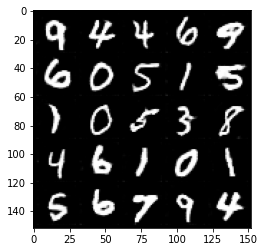

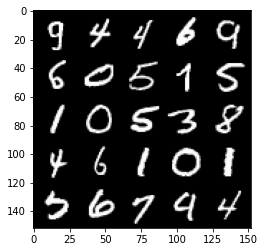

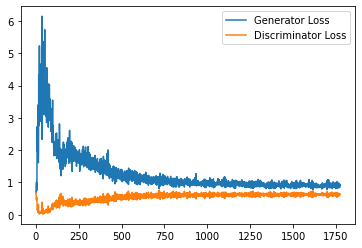

Step 36000: Generator loss: 0.9072697281837463, discriminator loss: 0.626905664563179


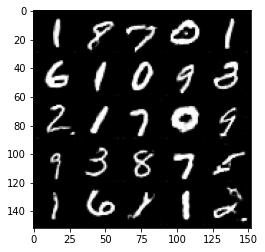

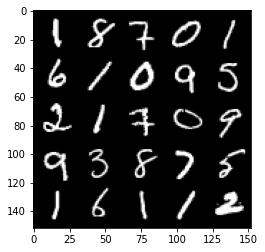

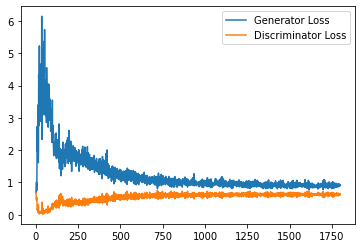

Step 36500: Generator loss: 0.9086237132549286, discriminator loss: 0.6243766218423843


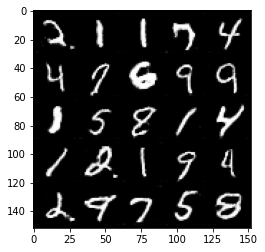

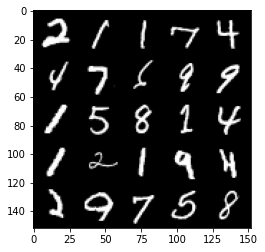

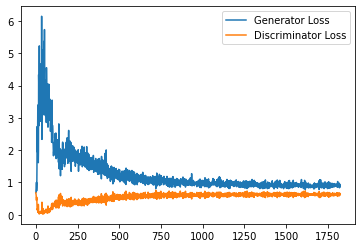

Step 37000: Generator loss: 0.9151065655946732, discriminator loss: 0.6201110483407974


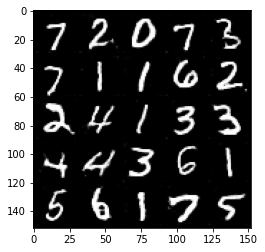

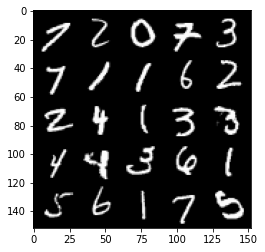

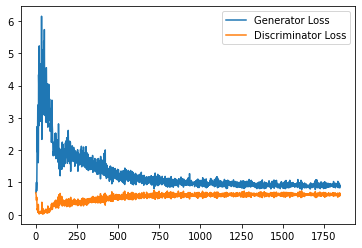

Step 37500: Generator loss: 0.9016552110910415, discriminator loss: 0.6248190564513206


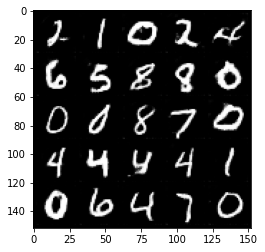

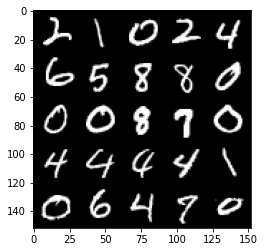

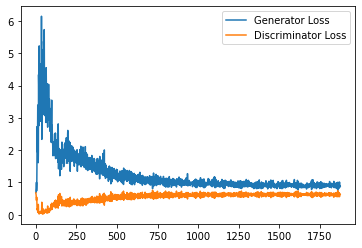

Step 38000: Generator loss: 0.8948747891187668, discriminator loss: 0.6253253710269928


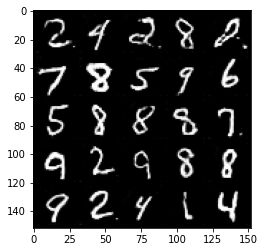

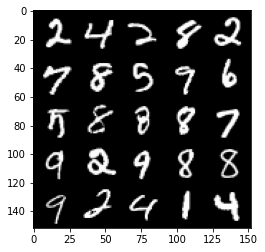

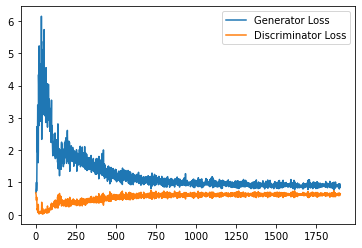

Step 38500: Generator loss: 0.9002131556272507, discriminator loss: 0.6264371089935302


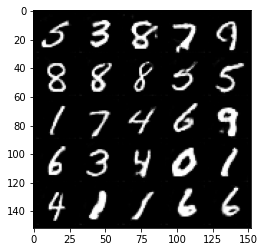

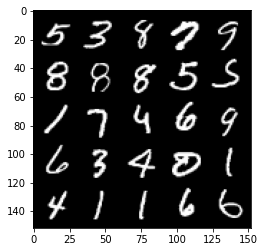

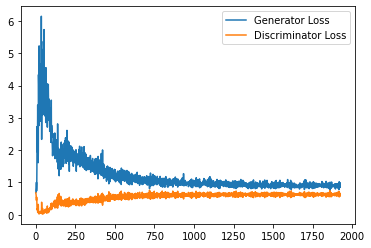

Step 39000: Generator loss: 0.9160895075798035, discriminator loss: 0.6231551578044892


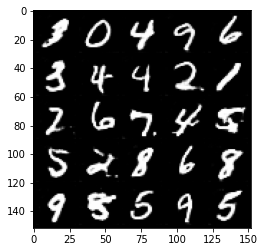

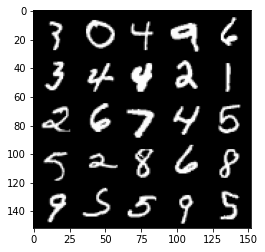

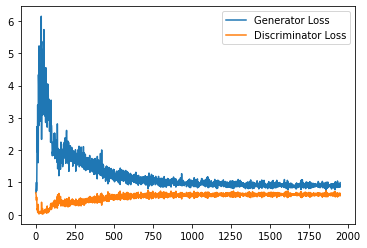

Step 39500: Generator loss: 0.92596337890625, discriminator loss: 0.6270564503669739


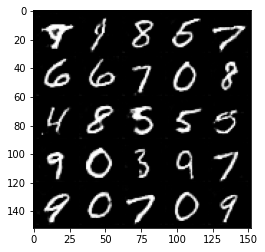

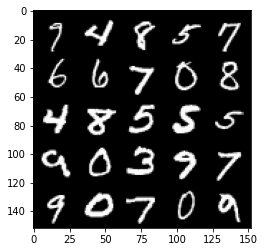

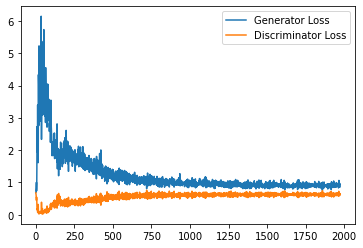

Step 40000: Generator loss: 0.9009879719018936, discriminator loss: 0.626691013932228


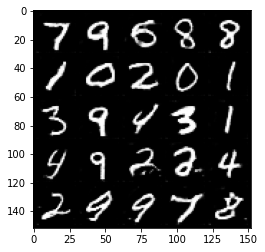

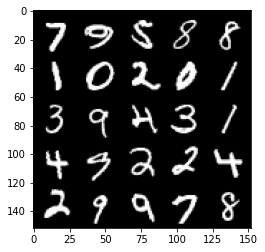

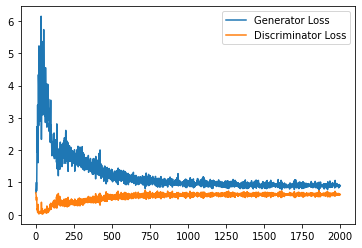

Step 40500: Generator loss: 0.9112327497005462, discriminator loss: 0.6241870467662811


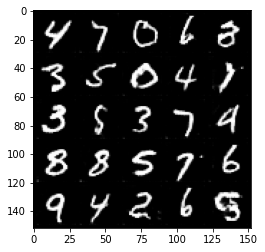

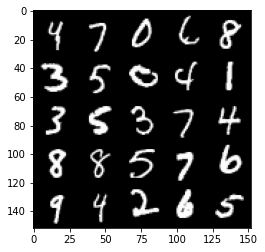

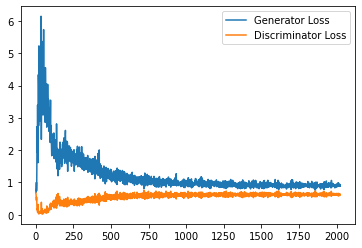

Step 41000: Generator loss: 0.9103455824851989, discriminator loss: 0.6278425257802009


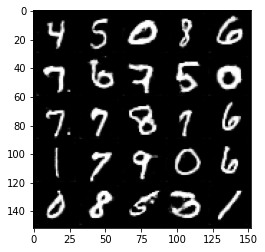

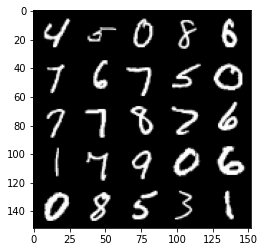

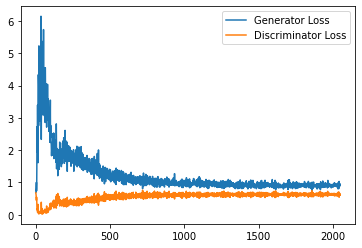

Step 41500: Generator loss: 0.9087444059848785, discriminator loss: 0.6257926144599915


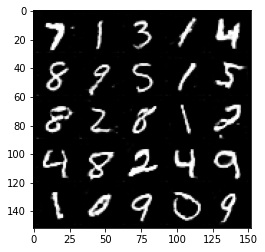

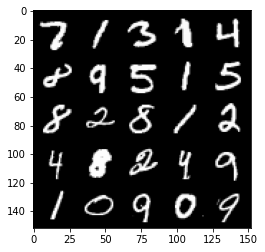

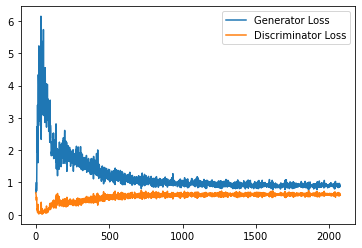

Step 42000: Generator loss: 0.9017427760362625, discriminator loss: 0.624019376039505


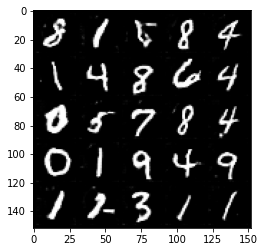

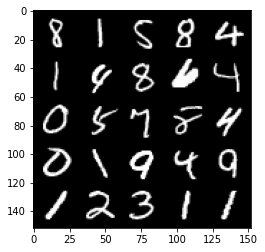

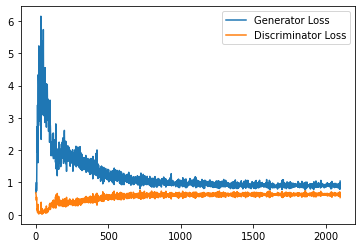

Step 42500: Generator loss: 0.9007823120355606, discriminator loss: 0.6265444339513778


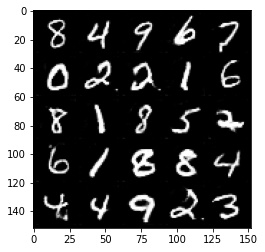

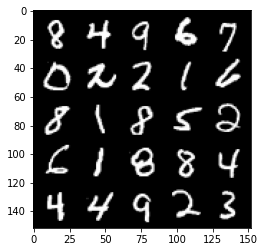

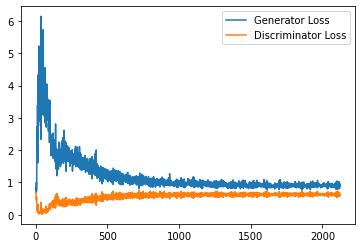

Step 43000: Generator loss: 0.9171610941886902, discriminator loss: 0.6236752755641938


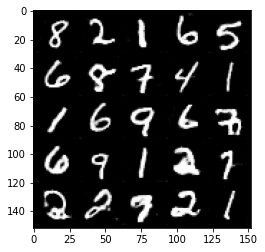

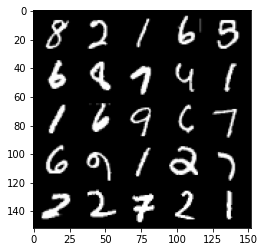

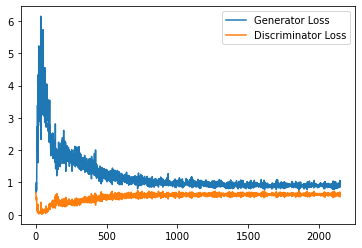

Step 43500: Generator loss: 0.9076534596681595, discriminator loss: 0.6229521438479424


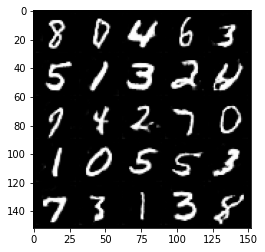

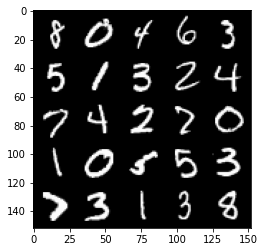

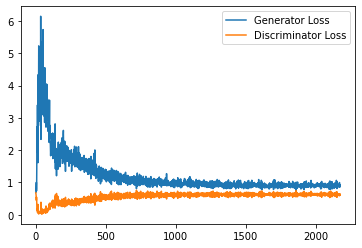

Step 44000: Generator loss: 0.9100229769945145, discriminator loss: 0.6203377559185028


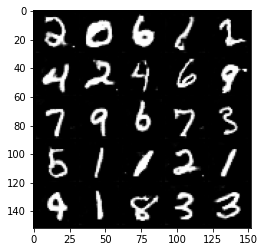

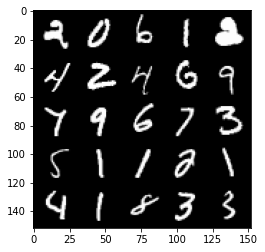

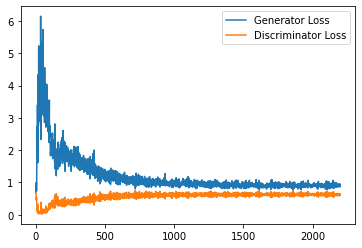

Step 44500: Generator loss: 0.9241914073228836, discriminator loss: 0.6249708957672119


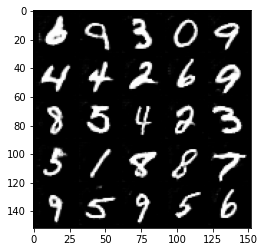

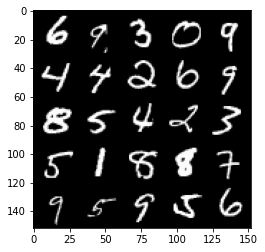

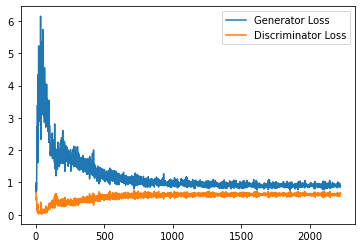

Step 45000: Generator loss: 0.9047775112390518, discriminator loss: 0.6247481474280357


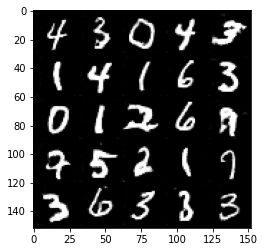

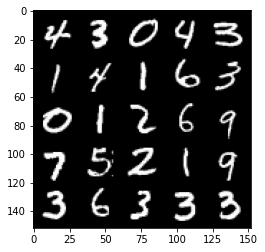

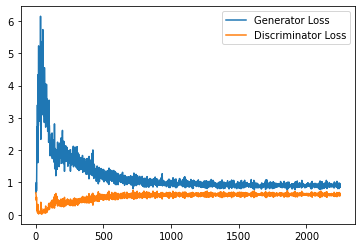

Step 45500: Generator loss: 0.8976484687328339, discriminator loss: 0.6262670901417732


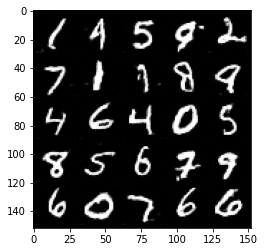

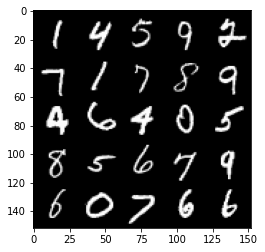

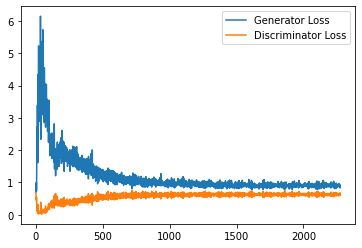

Step 46000: Generator loss: 0.9182791503667831, discriminator loss: 0.6292527862787247


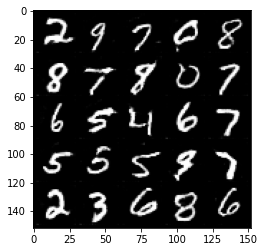

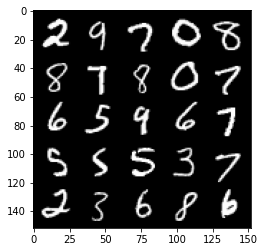

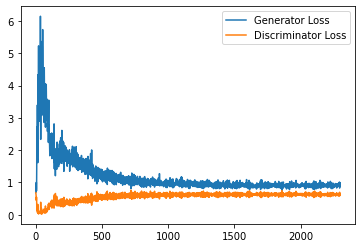

Step 46500: Generator loss: 0.9215708054304123, discriminator loss: 0.6242384730577469


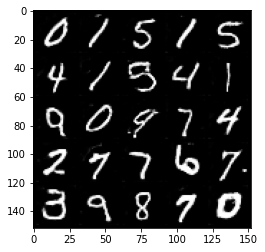

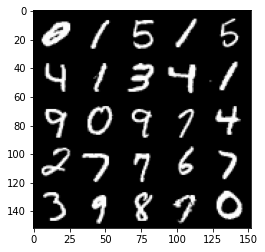

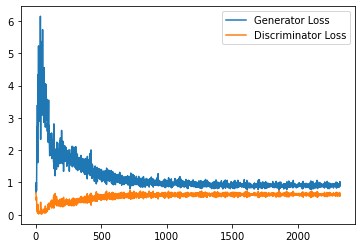

Step 47000: Generator loss: 0.9058121520280839, discriminator loss: 0.6252115099430084


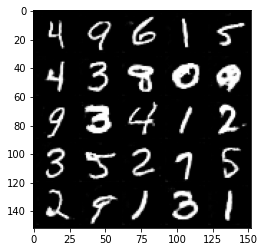

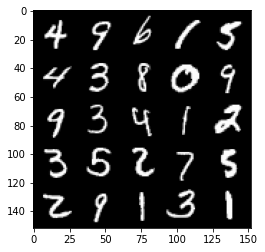

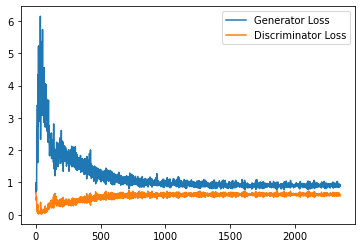

Step 47500: Generator loss: 0.907551682472229, discriminator loss: 0.6272319278717041


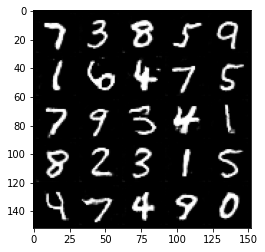

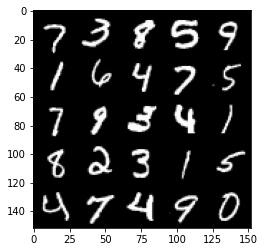

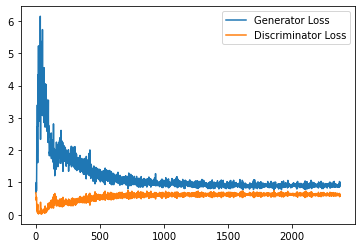

Step 48000: Generator loss: 0.9118783509731293, discriminator loss: 0.6264722383022309


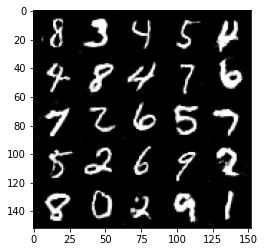

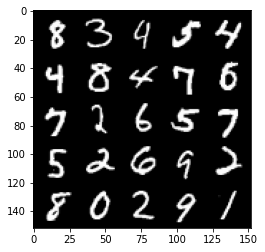

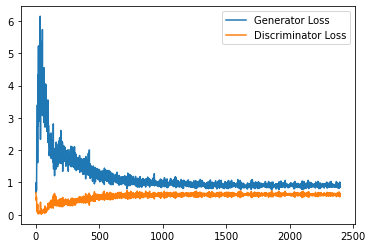

Step 48500: Generator loss: 0.9169166244268417, discriminator loss: 0.6236056901216507


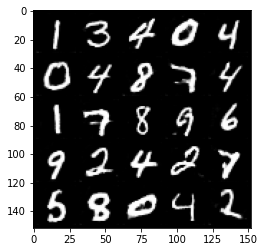

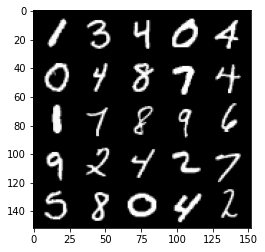

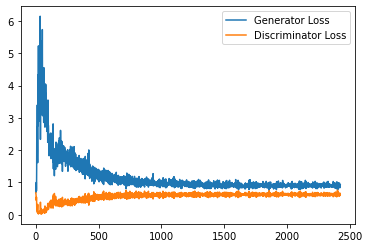

Step 49000: Generator loss: 0.9088259930610657, discriminator loss: 0.6236552128791809


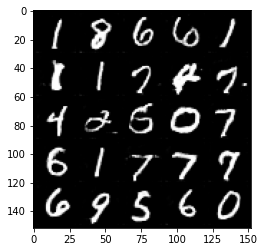

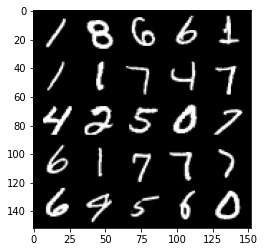

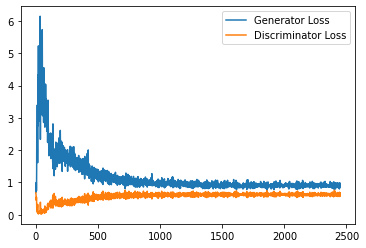

Step 49500: Generator loss: 0.9152834937572479, discriminator loss: 0.6190635161399841


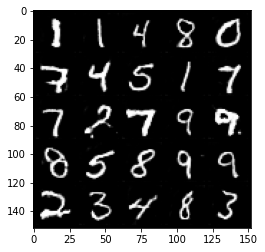

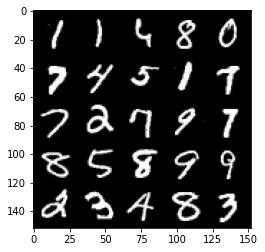

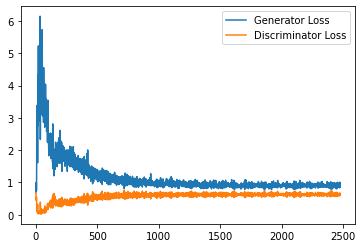

Step 50000: Generator loss: 0.9123365923166274, discriminator loss: 0.6223750945329666


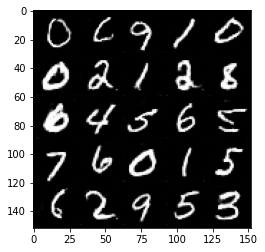

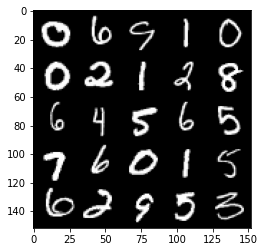

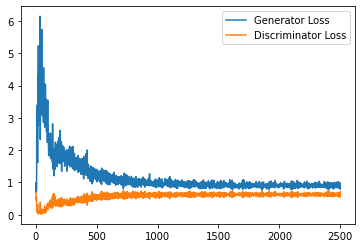

Step 50500: Generator loss: 0.9121387956142426, discriminator loss: 0.6200321332216263


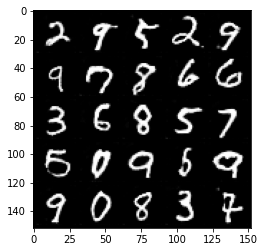

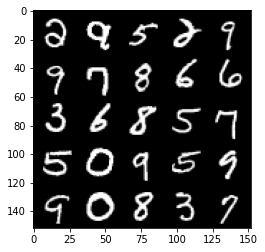

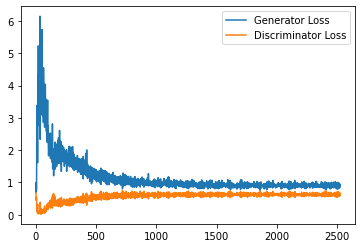

Step 51000: Generator loss: 0.9208144336938858, discriminator loss: 0.620955656528473


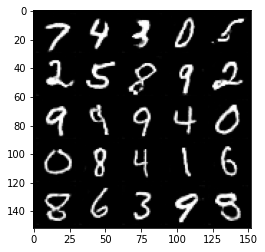

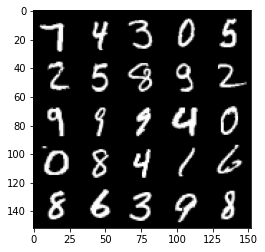

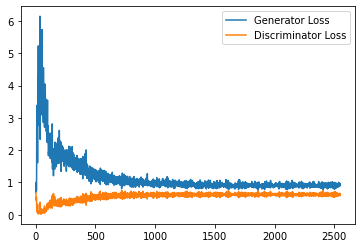

Step 51500: Generator loss: 0.9353751697540283, discriminator loss: 0.6203588085770607


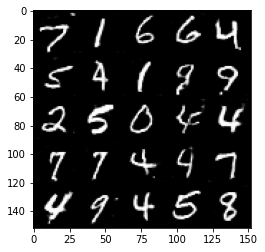

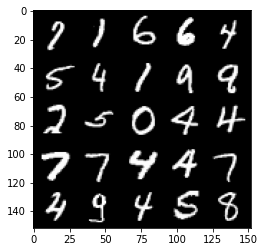

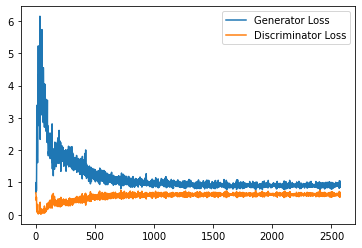

Step 52000: Generator loss: 0.9249837386608124, discriminator loss: 0.6200640470981598


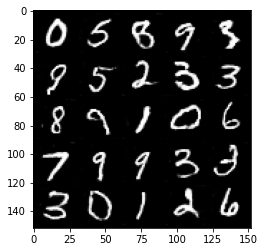

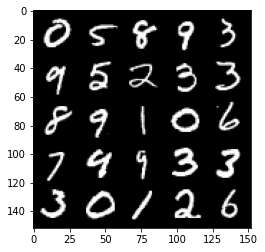

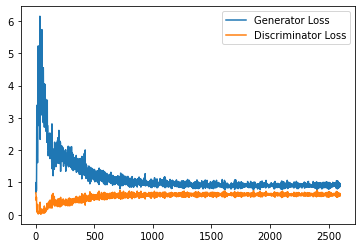

Step 52500: Generator loss: 0.9232256006002426, discriminator loss: 0.6226510232686997


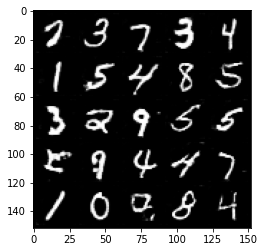

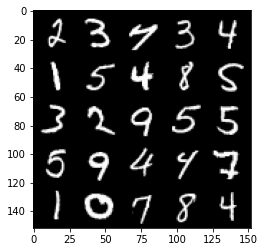

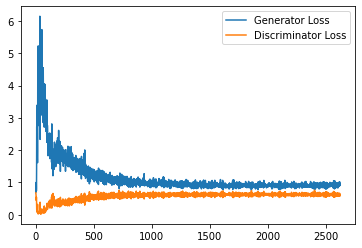

Step 53000: Generator loss: 0.9252798324823379, discriminator loss: 0.6223213838338852


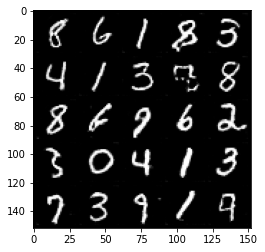

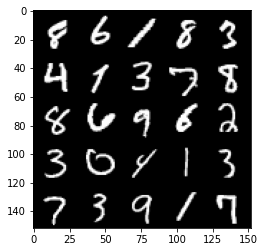

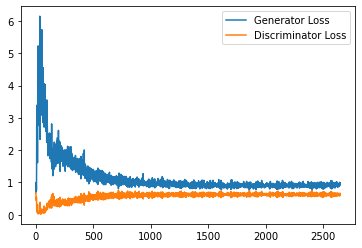

Step 53500: Generator loss: 0.9461536989212036, discriminator loss: 0.618208961725235


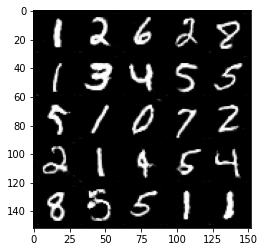

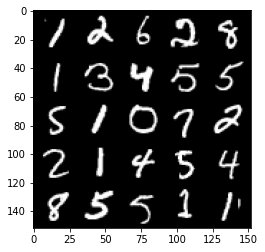

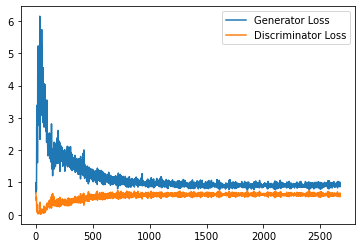

Step 54000: Generator loss: 0.921604380607605, discriminator loss: 0.6213779050111771


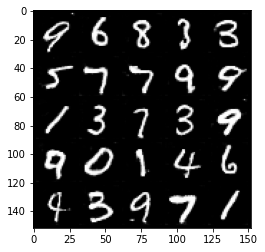

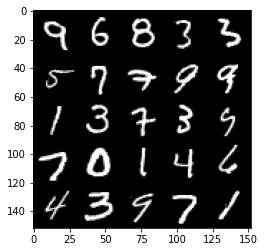

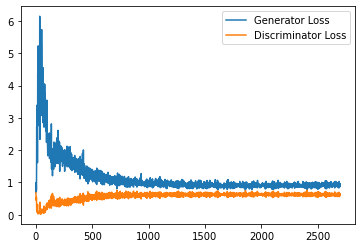

Step 54500: Generator loss: 0.9179791184663773, discriminator loss: 0.6173883327841758


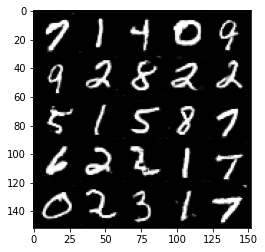

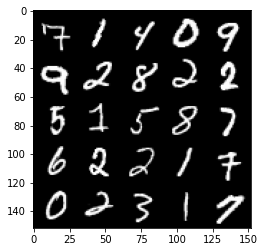

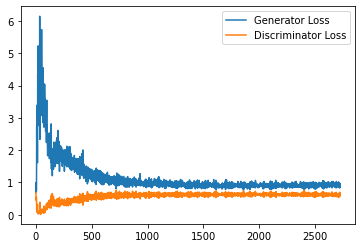

Step 55000: Generator loss: 0.9117505487203598, discriminator loss: 0.620247646689415


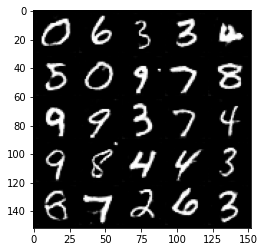

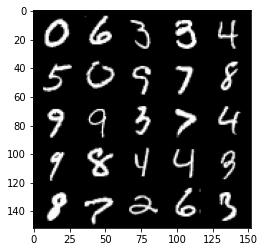

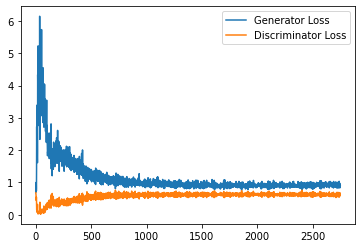

Step 55500: Generator loss: 0.9275408480167389, discriminator loss: 0.6148469914197922


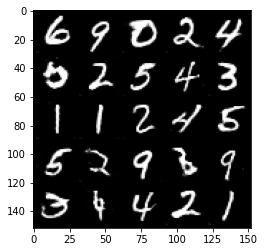

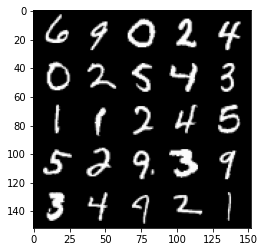

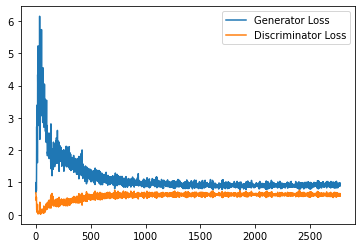

Step 56000: Generator loss: 0.9416139349937439, discriminator loss: 0.619621774494648


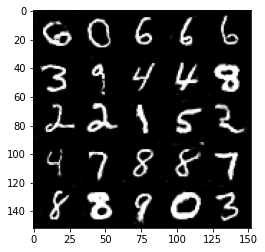

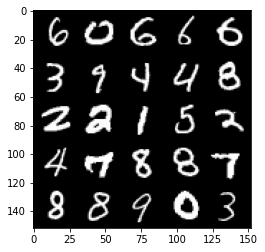

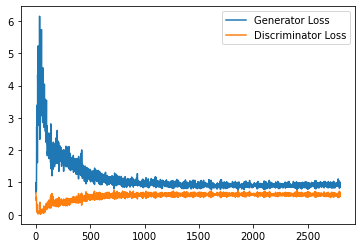

Step 56500: Generator loss: 0.935727991938591, discriminator loss: 0.6178711692094803


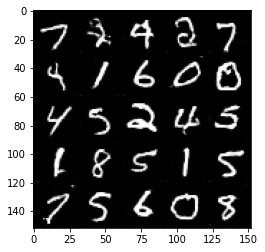

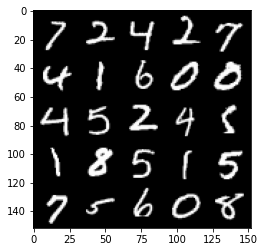

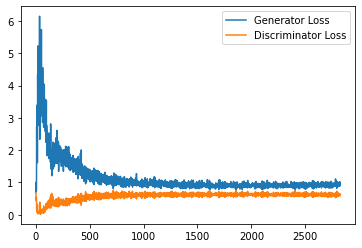

Step 57000: Generator loss: 0.9244902230501175, discriminator loss: 0.6192792026996613


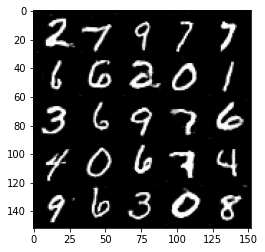

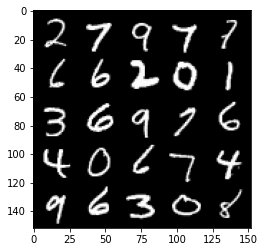

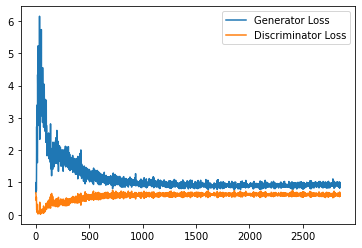

Step 57500: Generator loss: 0.9298212155103683, discriminator loss: 0.6158381892442704


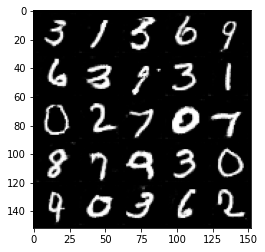

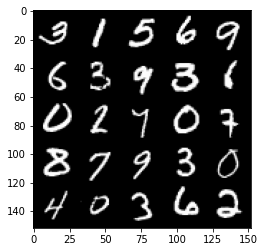

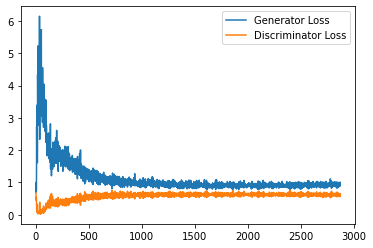

Step 58000: Generator loss: 0.930534564614296, discriminator loss: 0.620883622288704


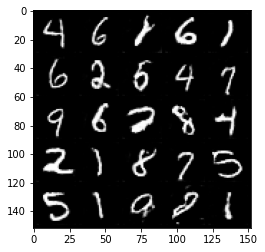

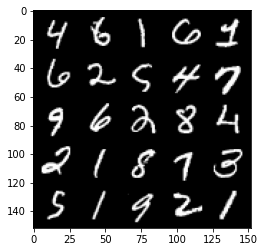

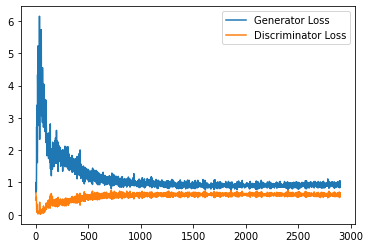

Step 58500: Generator loss: 0.927096408367157, discriminator loss: 0.614306278347969


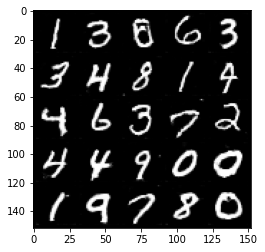

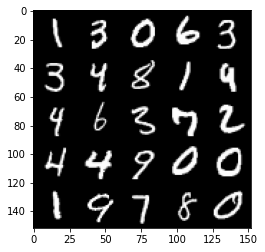

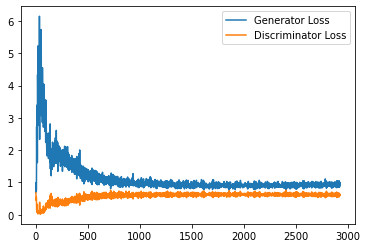

Step 59000: Generator loss: 0.9317619832754135, discriminator loss: 0.6191484633684158


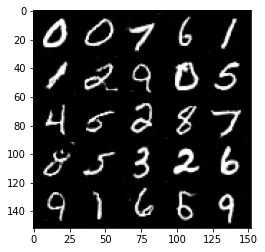

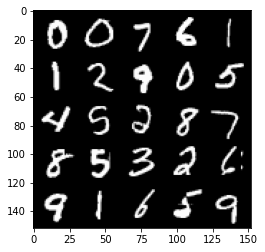

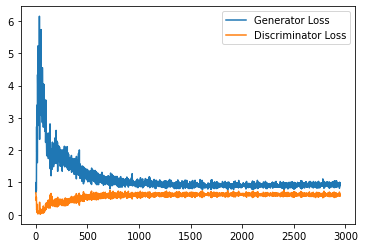

Step 59500: Generator loss: 0.9320035177469254, discriminator loss: 0.6180861748456955


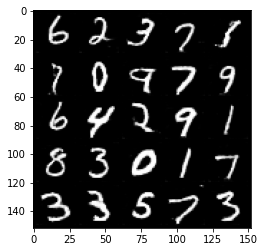

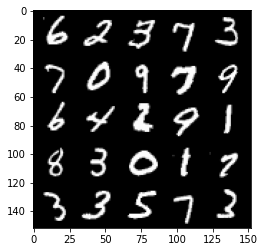

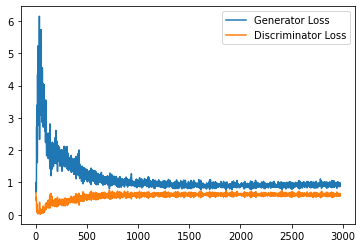

Step 60000: Generator loss: 0.9440506763458252, discriminator loss: 0.6196330555081367


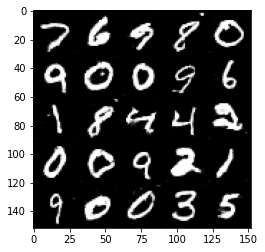

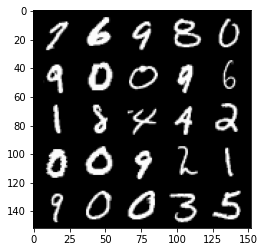

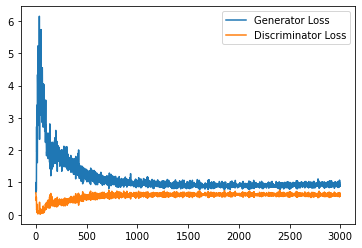

Step 60500: Generator loss: 0.9377932378053665, discriminator loss: 0.6157253887653351


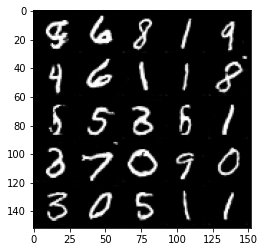

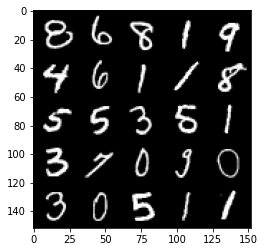

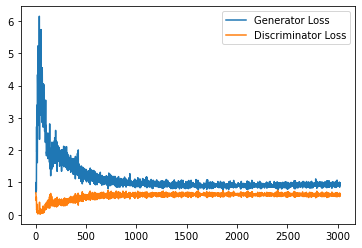

Step 61000: Generator loss: 0.923859280347824, discriminator loss: 0.61671943962574


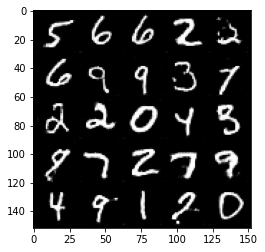

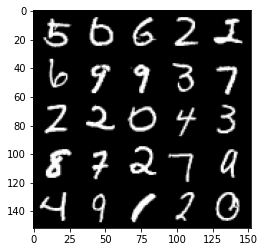

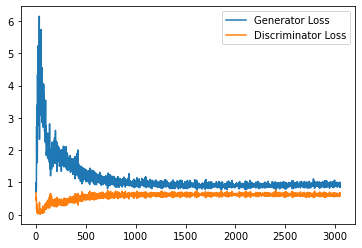

Step 61500: Generator loss: 0.9400544154644013, discriminator loss: 0.6168238722085952


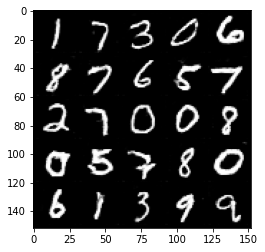

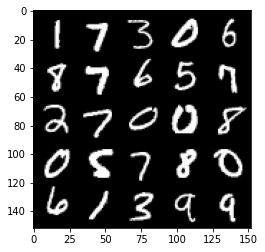

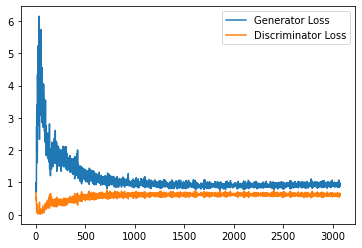

Step 62000: Generator loss: 0.9259331432580948, discriminator loss: 0.6147858591079712


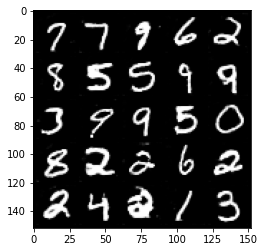

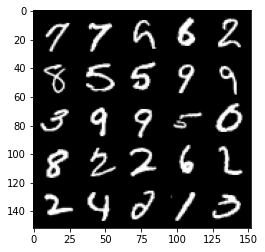

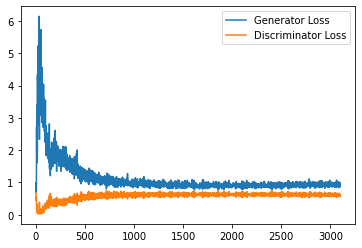

Step 62500: Generator loss: 0.9315917277336121, discriminator loss: 0.614869567990303


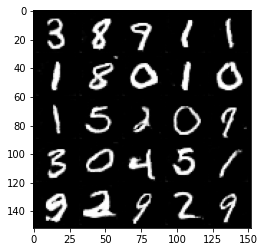

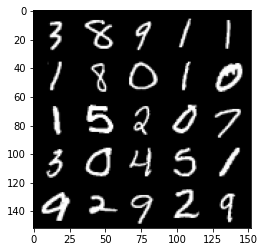

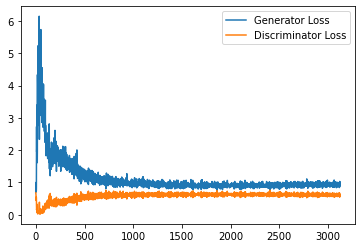

Step 63000: Generator loss: 0.9364128423929214, discriminator loss: 0.6141601365208625


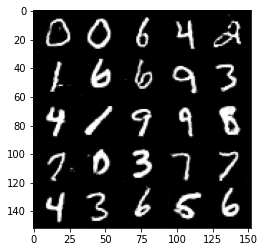

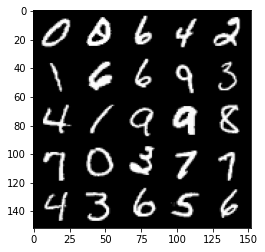

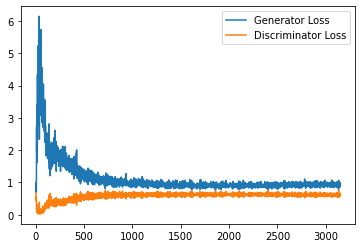

Step 63500: Generator loss: 0.9403969829082489, discriminator loss: 0.6132600808143616


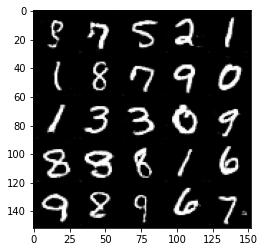

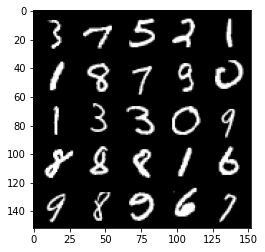

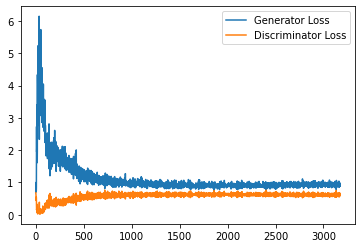

Step 64000: Generator loss: 0.9267879846096039, discriminator loss: 0.6111763092279434


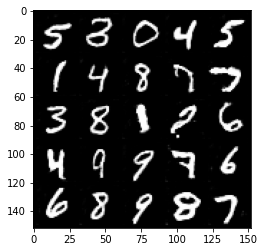

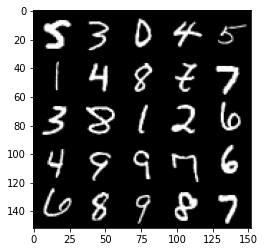

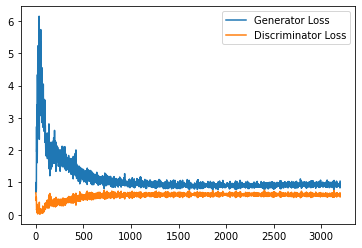

Step 64500: Generator loss: 0.9383918070793151, discriminator loss: 0.615836452126503


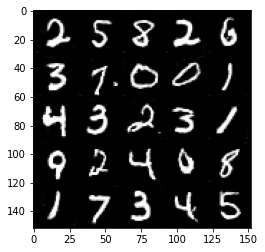

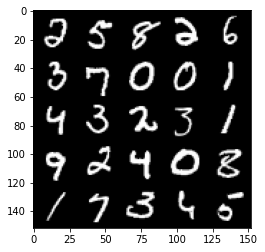

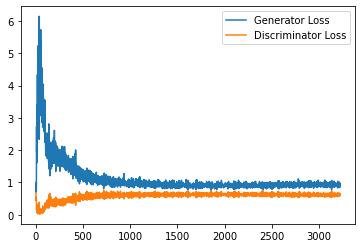

Step 65000: Generator loss: 0.9397370365858078, discriminator loss: 0.6144562417268753


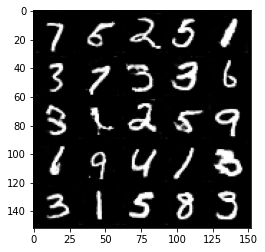

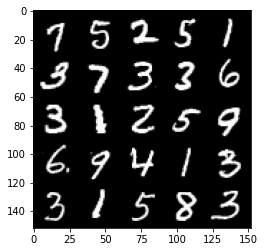

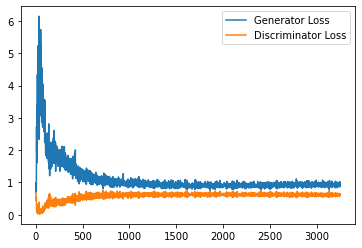

Step 65500: Generator loss: 0.946685110092163, discriminator loss: 0.6103820749521256


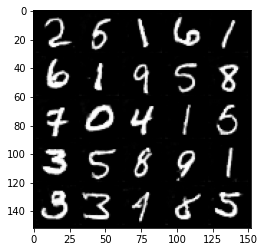

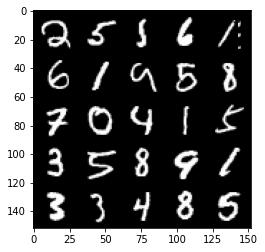

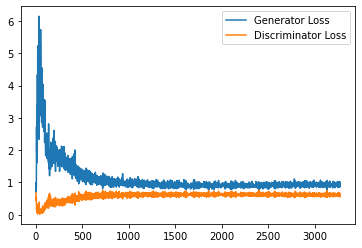

Step 66000: Generator loss: 0.9355660102367401, discriminator loss: 0.6148127172589302


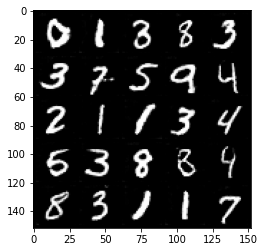

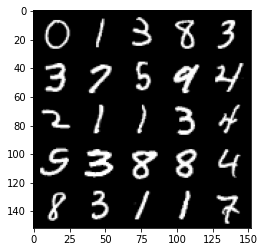

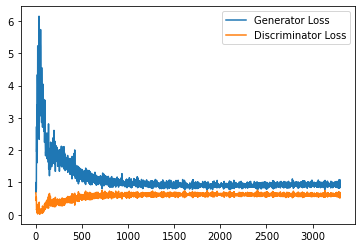

Step 66500: Generator loss: 0.9386515182256698, discriminator loss: 0.610955197930336


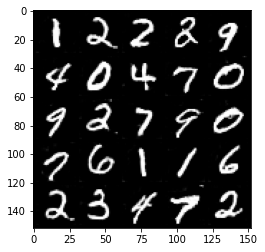

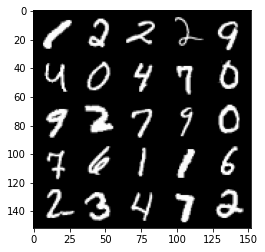

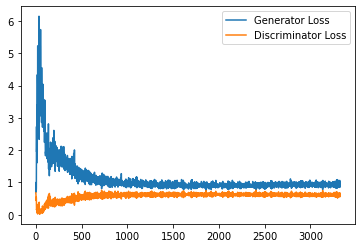

Step 67000: Generator loss: 0.9455073448419571, discriminator loss: 0.6119142243266106


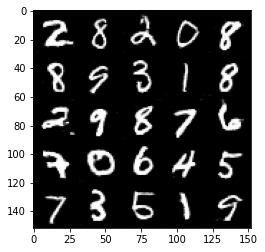

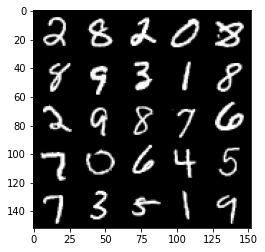

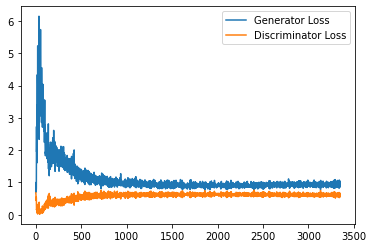

Step 67500: Generator loss: 0.9520274333953858, discriminator loss: 0.6105119994282723


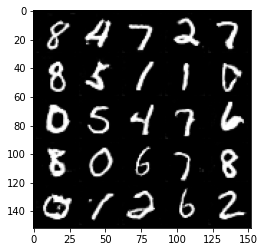

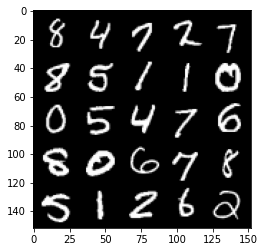

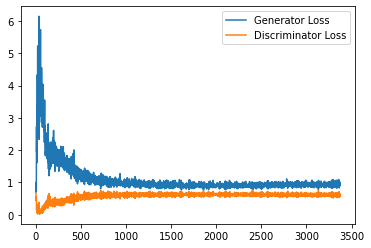

Step 68000: Generator loss: 0.9423452240228652, discriminator loss: 0.6082473365068436


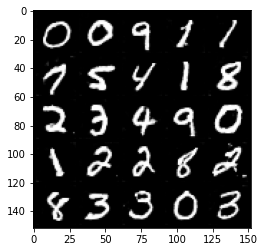

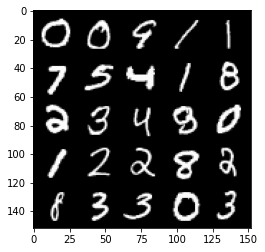

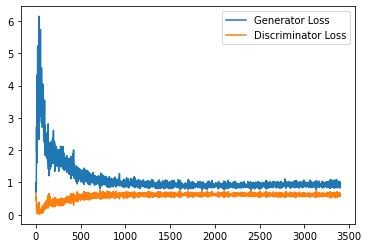

Step 68500: Generator loss: 0.9559296296834946, discriminator loss: 0.6104441071748734


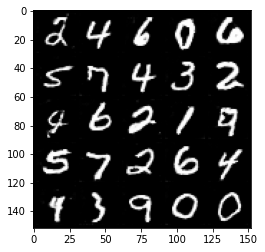

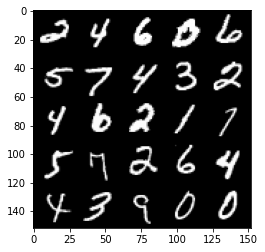

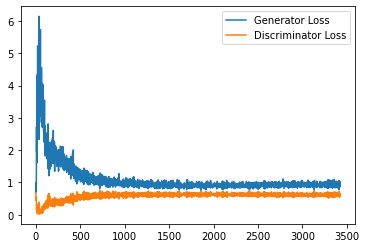

Step 69000: Generator loss: 0.941745024561882, discriminator loss: 0.6081981959939003


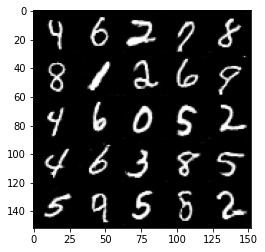

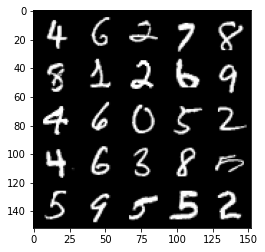

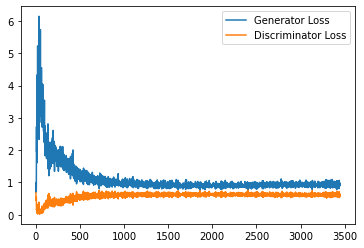

Step 69500: Generator loss: 0.9335411343574523, discriminator loss: 0.6103512853980064


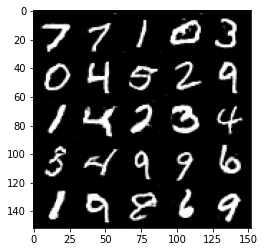

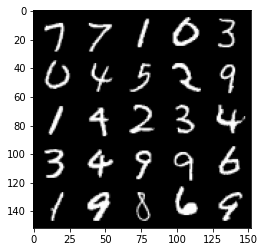

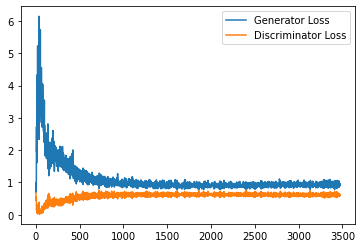

Step 70000: Generator loss: 0.934746280670166, discriminator loss: 0.6087555463314056


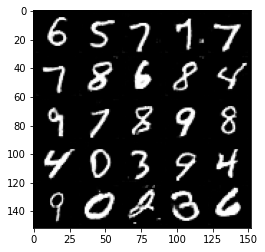

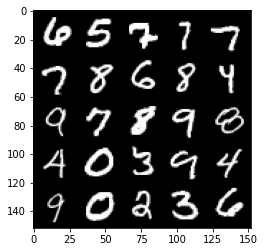

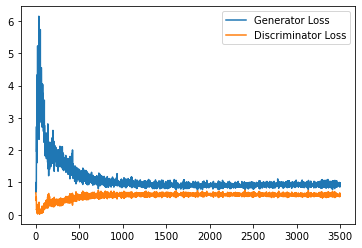

Step 70500: Generator loss: 0.9468846807479858, discriminator loss: 0.6113191754817963


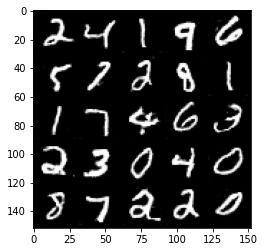

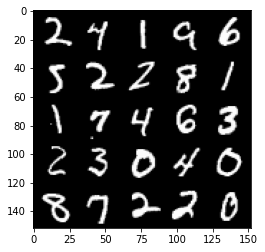

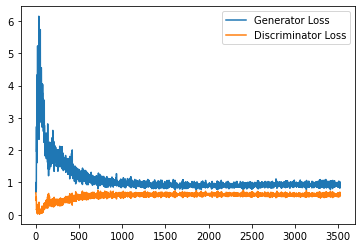

Step 71000: Generator loss: 0.9507693289518356, discriminator loss: 0.6090986613035202


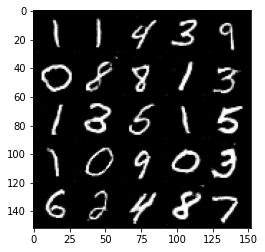

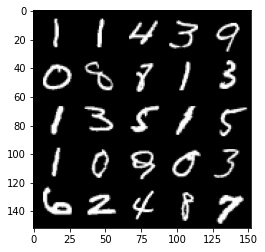

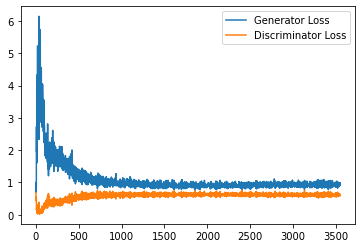

Step 71500: Generator loss: 0.942038175702095, discriminator loss: 0.6106682248115539


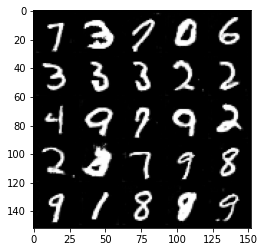

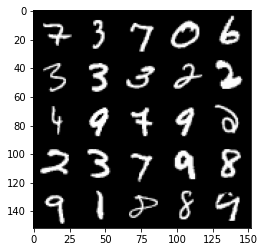

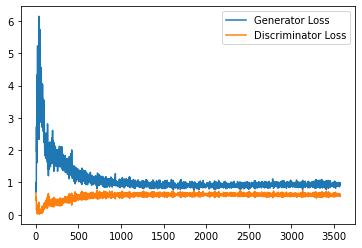

Step 72000: Generator loss: 0.9491613277196884, discriminator loss: 0.6101154501438141


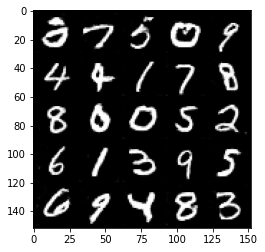

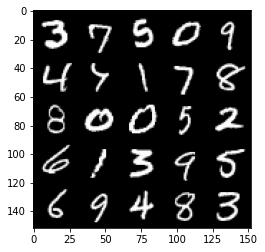

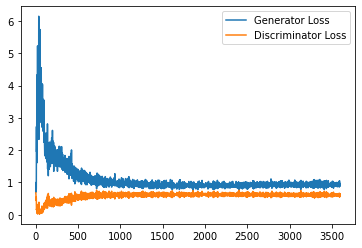

Step 72500: Generator loss: 0.9307858918905259, discriminator loss: 0.6102511448860168


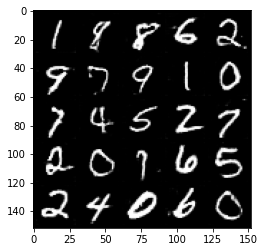

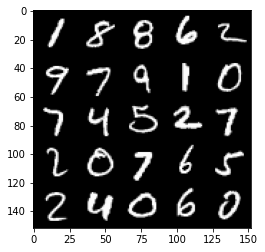

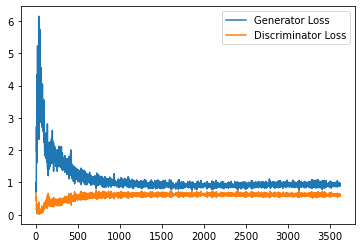

Step 73000: Generator loss: 0.9282257523536682, discriminator loss: 0.6099815818071366


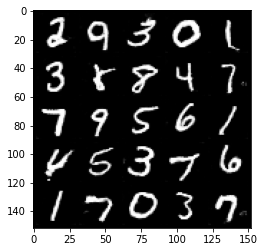

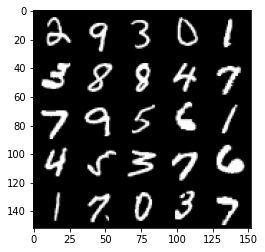

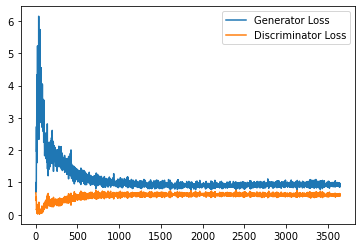

Step 73500: Generator loss: 0.9505980365276336, discriminator loss: 0.6129765021204948


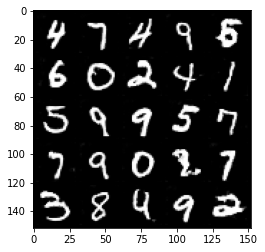

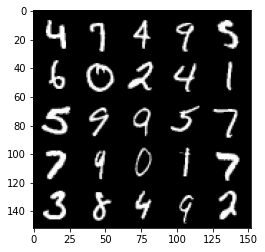

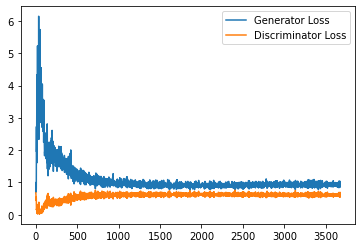

Step 74000: Generator loss: 0.9577071410417557, discriminator loss: 0.6093783819675446


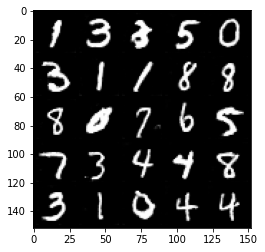

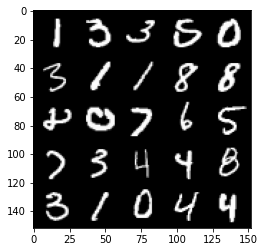

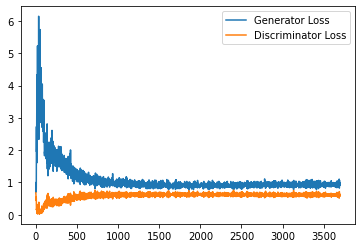

Step 74500: Generator loss: 0.9332367380857468, discriminator loss: 0.6091642794013024


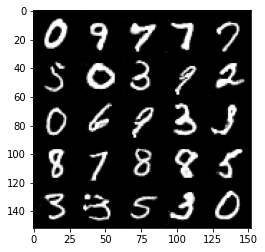

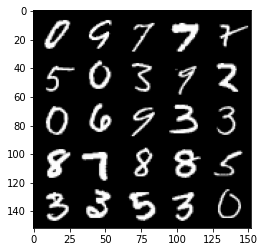

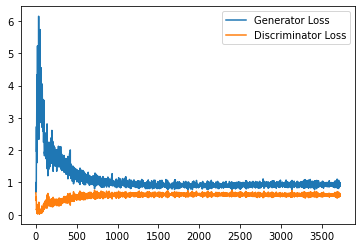

Step 75000: Generator loss: 0.9416153873205185, discriminator loss: 0.6124324033856392


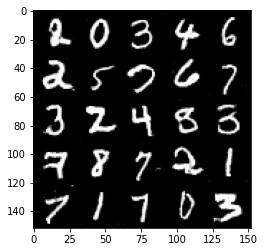

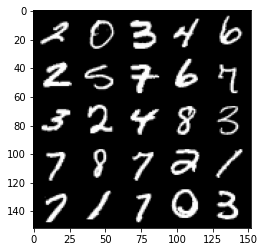

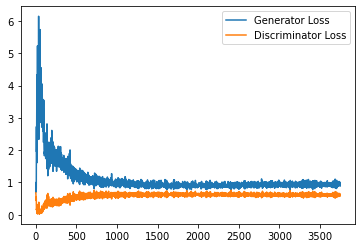

Step 75500: Generator loss: 0.940280335187912, discriminator loss: 0.607733895778656


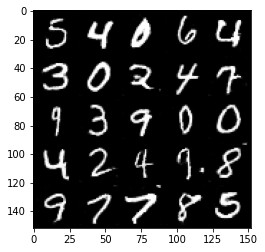

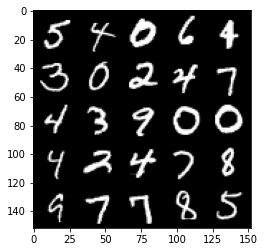

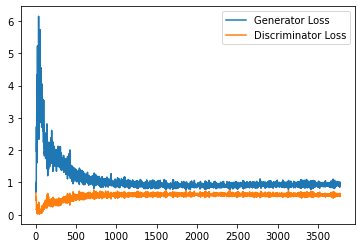

Step 76000: Generator loss: 0.9428136143684387, discriminator loss: 0.6113827303647995


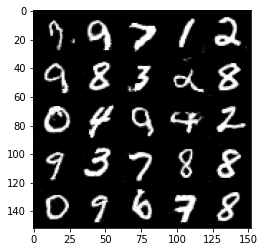

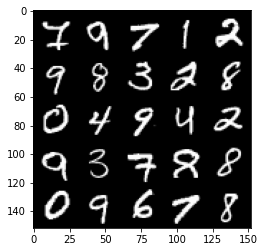

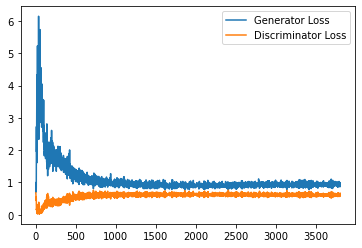

Step 76500: Generator loss: 0.9426445074081421, discriminator loss: 0.6092287512421608


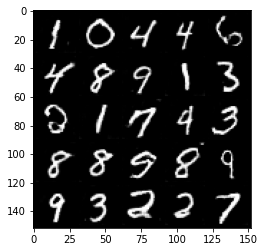

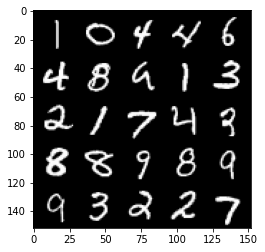

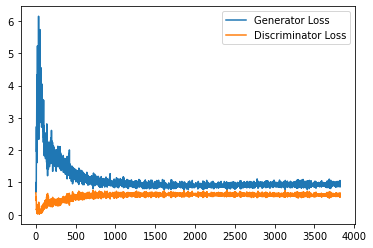

Step 77000: Generator loss: 0.9535222314596176, discriminator loss: 0.6095631179213524


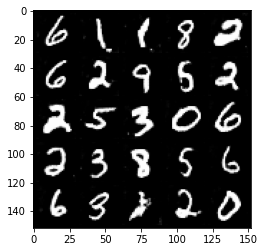

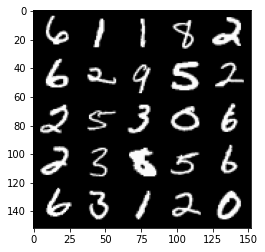

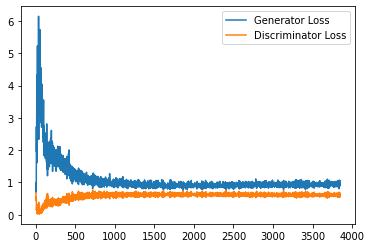

Step 77500: Generator loss: 0.9420434452295303, discriminator loss: 0.6075218413472175


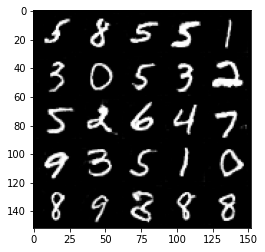

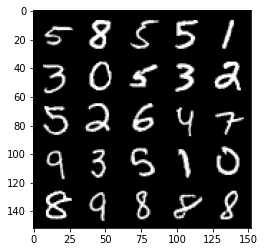

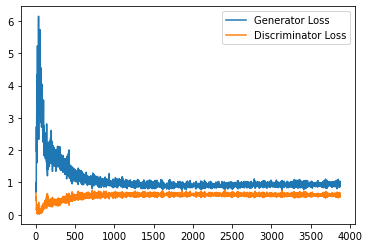

Step 78000: Generator loss: 0.9473386619091034, discriminator loss: 0.608015911579132


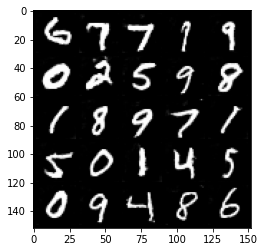

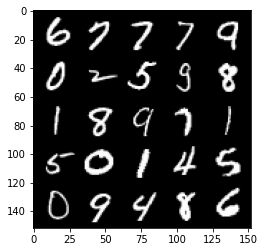

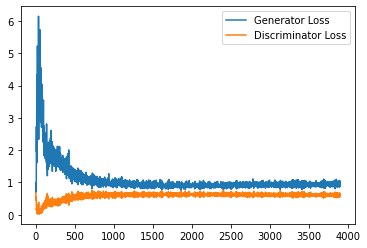

Step 78500: Generator loss: 0.9377496048212052, discriminator loss: 0.6097835224270821


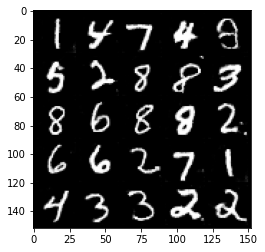

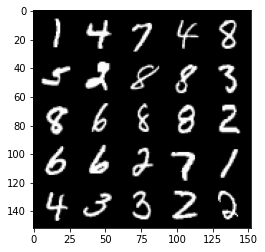

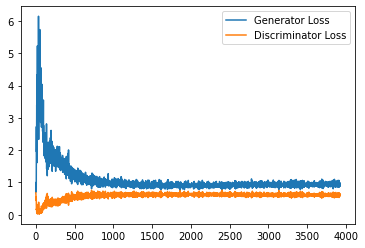

Step 79000: Generator loss: 0.9466243876218796, discriminator loss: 0.6109559952616691


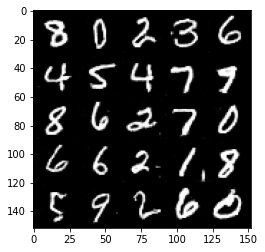

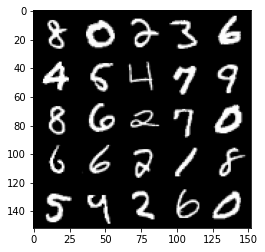

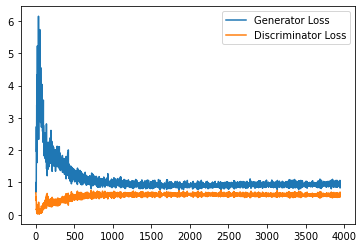

Step 79500: Generator loss: 0.9624743064641953, discriminator loss: 0.6127910965681076


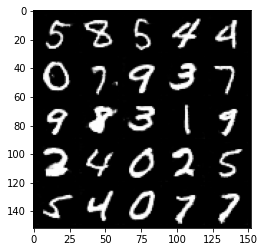

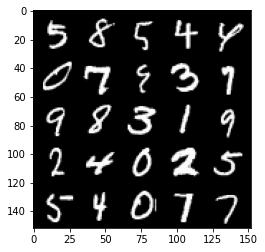

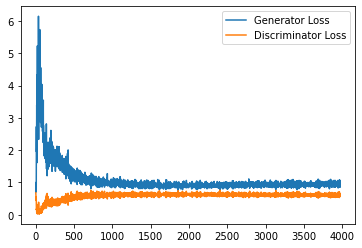

Step 80000: Generator loss: 0.9522442816495895, discriminator loss: 0.6101548855304718


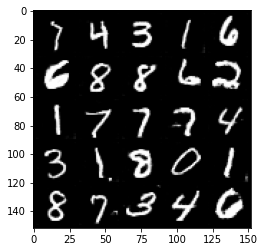

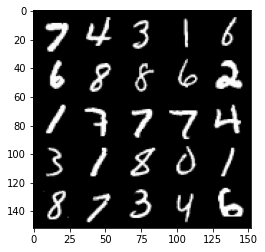

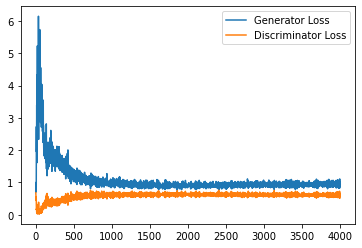

Step 80500: Generator loss: 0.9441790021657944, discriminator loss: 0.6079172052145004


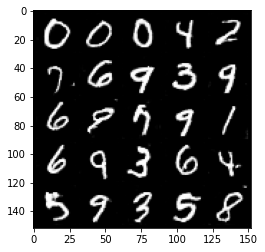

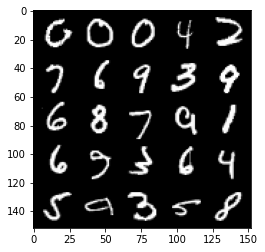

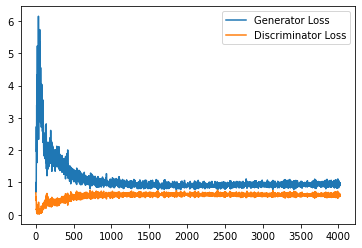

Step 81000: Generator loss: 0.9517192546129226, discriminator loss: 0.6101992416381836


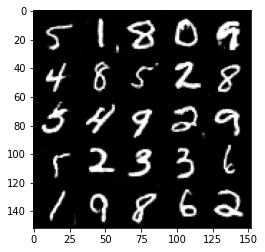

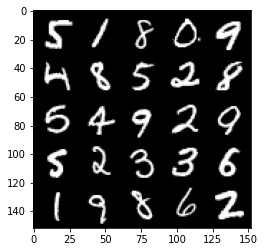

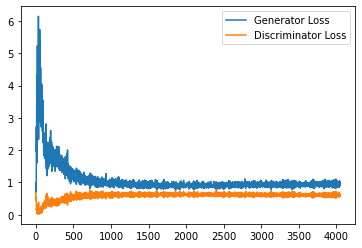

Step 81500: Generator loss: 0.9453113887310028, discriminator loss: 0.6112411390542984


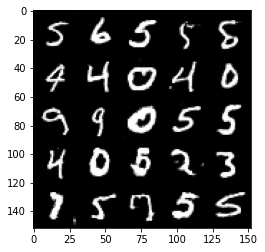

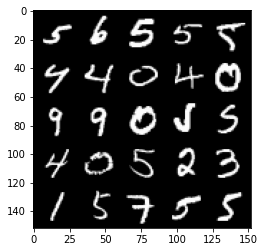

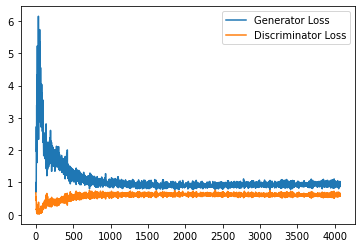

Step 82000: Generator loss: 0.9470573748350144, discriminator loss: 0.6095060178637505


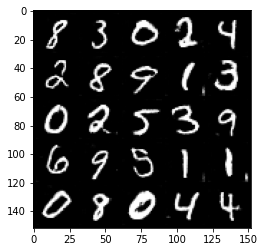

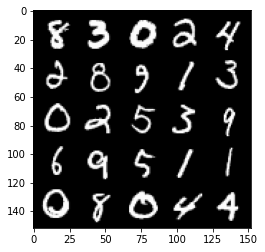

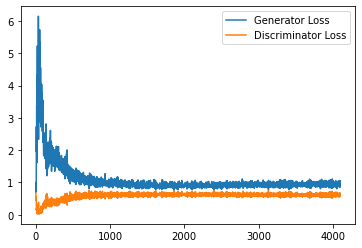

Step 82500: Generator loss: 0.948687392950058, discriminator loss: 0.6094940017461776


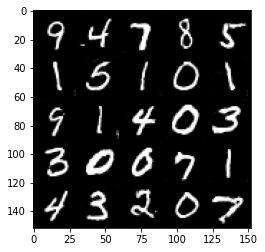

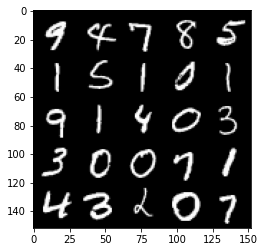

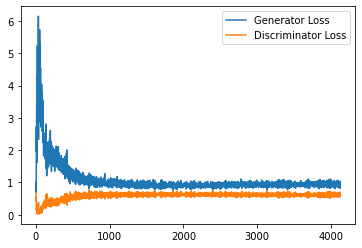

Step 83000: Generator loss: 0.9428108487129211, discriminator loss: 0.6101198500394821


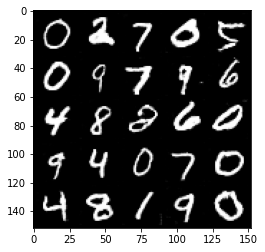

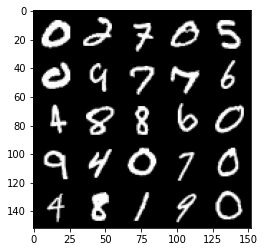

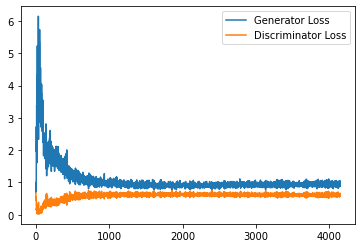

Step 83500: Generator loss: 0.9476584506034851, discriminator loss: 0.6128133518695831


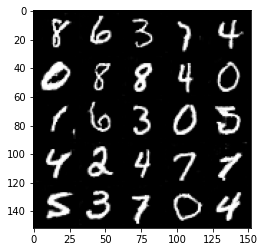

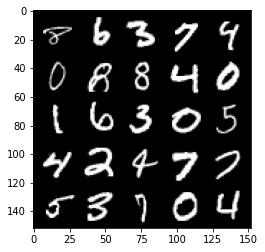

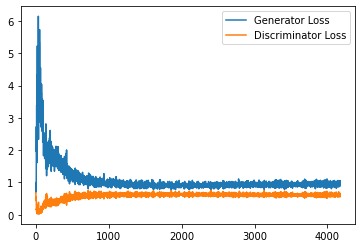

Step 84000: Generator loss: 0.9626706202030182, discriminator loss: 0.6060285103321076


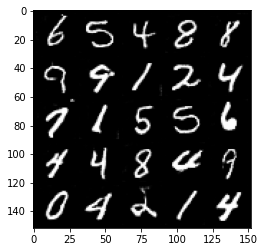

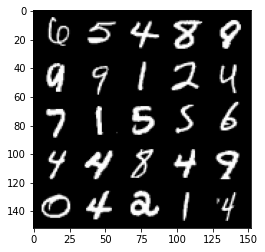

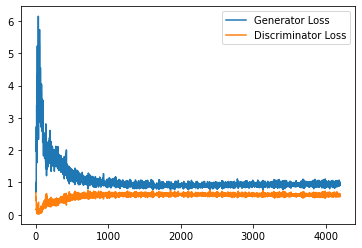

Step 84500: Generator loss: 0.9488367441892623, discriminator loss: 0.6136330907344818


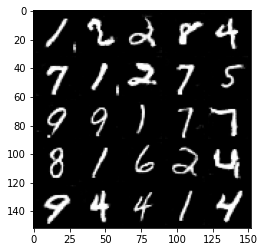

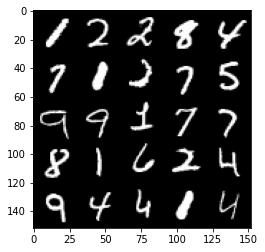

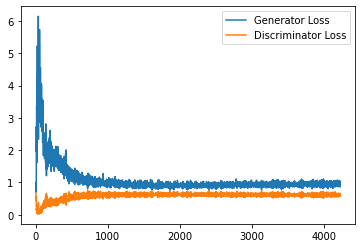

Step 85000: Generator loss: 0.9362366480827331, discriminator loss: 0.6099228850603103


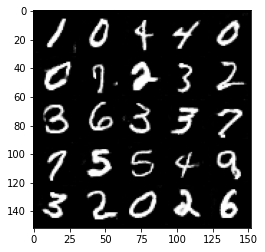

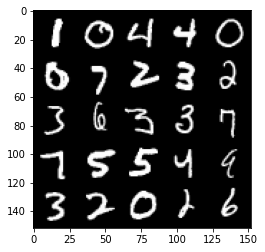

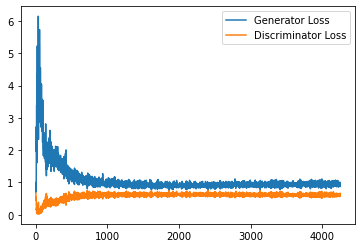

Step 85500: Generator loss: 0.9618819961547852, discriminator loss: 0.6043252555131913


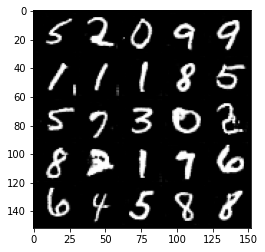

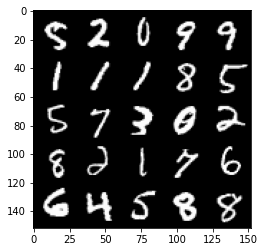

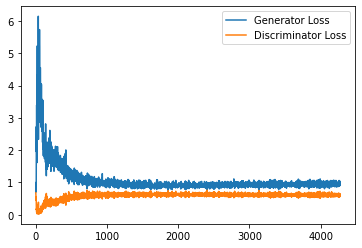

Step 86000: Generator loss: 0.9613945838212967, discriminator loss: 0.6066963582634926


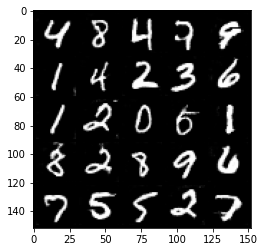

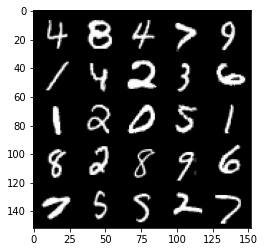

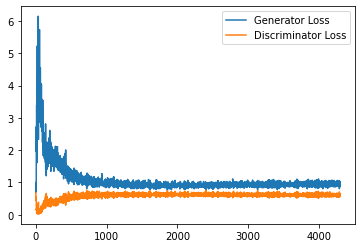

Step 86500: Generator loss: 0.9478539078235626, discriminator loss: 0.6086222768425942


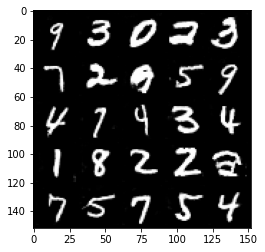

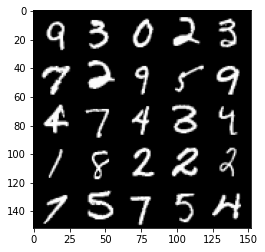

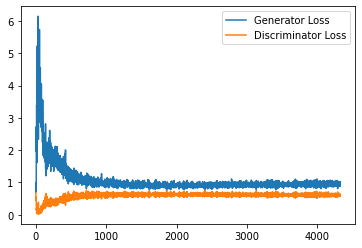

Step 87000: Generator loss: 0.9490350999832153, discriminator loss: 0.6120290648937226


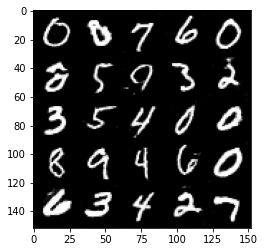

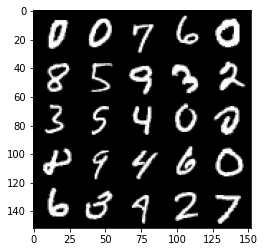

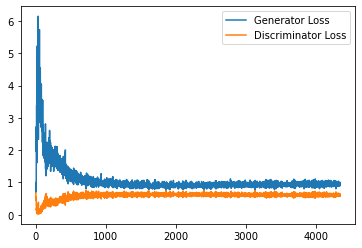

Step 87500: Generator loss: 0.9376339175701142, discriminator loss: 0.6068085449337959


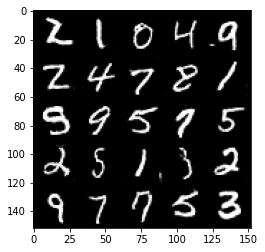

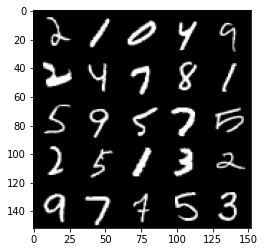

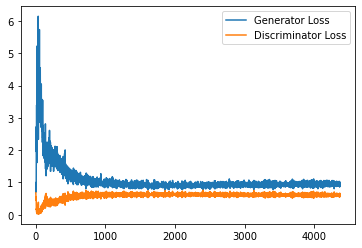

Step 88000: Generator loss: 0.9630295128822327, discriminator loss: 0.6099377920627594


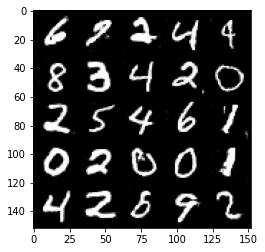

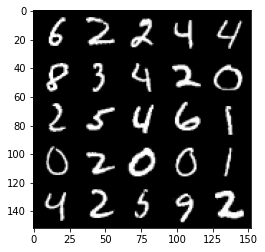

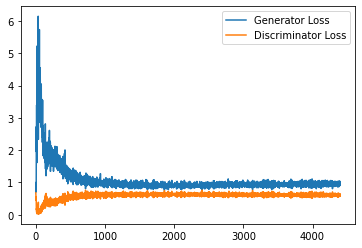

Step 88500: Generator loss: 0.9463231912851333, discriminator loss: 0.6122239064574242


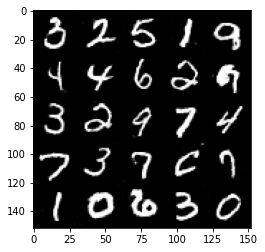

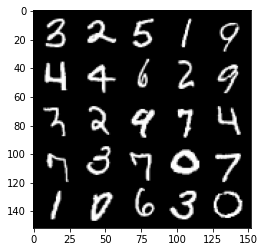

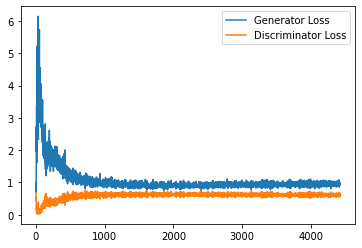

Step 89000: Generator loss: 0.9392371673583985, discriminator loss: 0.6105648500919342


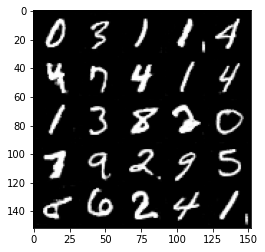

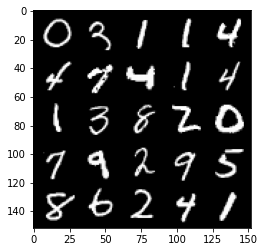

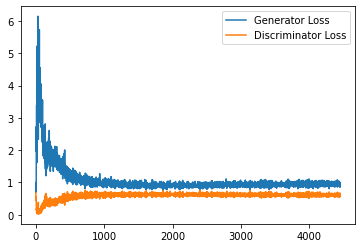

Step 89500: Generator loss: 0.9606347975730896, discriminator loss: 0.6077237687706948


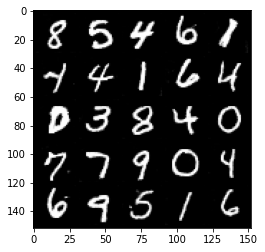

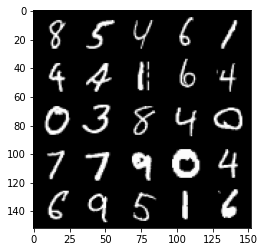

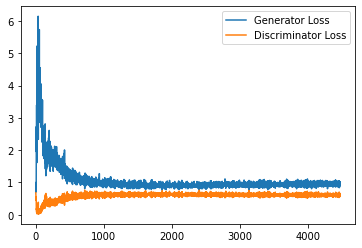

Step 90000: Generator loss: 0.9493388719558716, discriminator loss: 0.6111131678819657


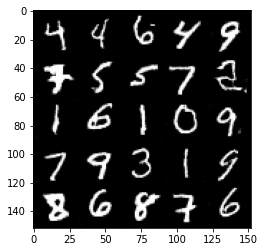

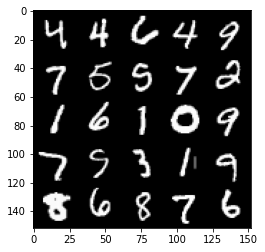

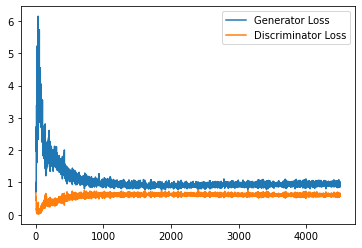

Step 90500: Generator loss: 0.9505395039319992, discriminator loss: 0.6090217591524124


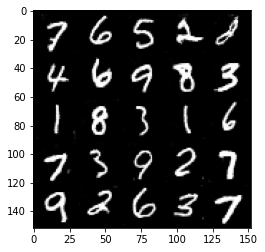

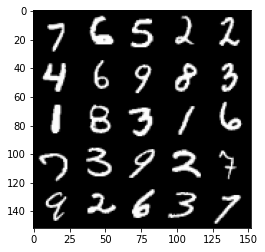

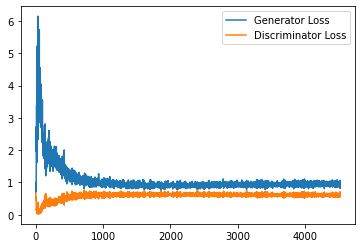

Step 91000: Generator loss: 0.9497339940071106, discriminator loss: 0.6121872938275337


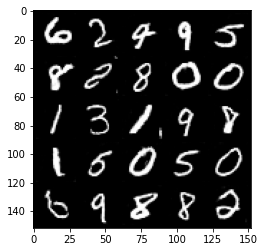

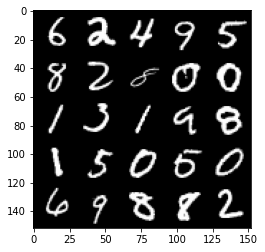

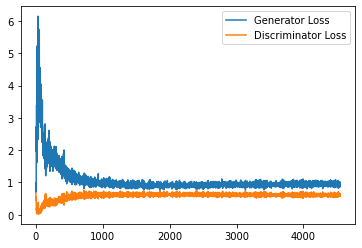

Step 91500: Generator loss: 0.9309247516393662, discriminator loss: 0.614480907022953


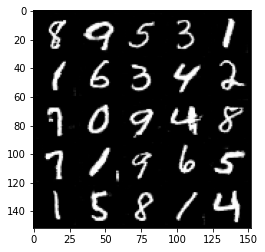

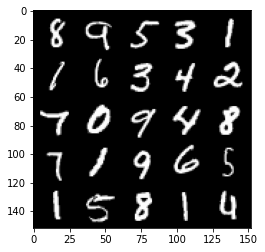

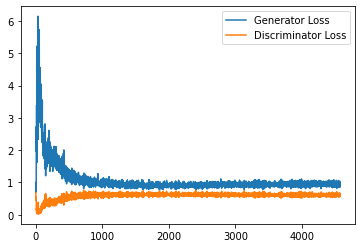

Step 92000: Generator loss: 0.9630100646018982, discriminator loss: 0.6129176328182221


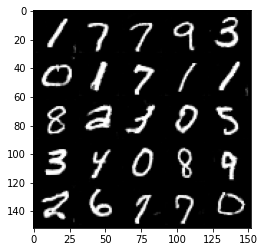

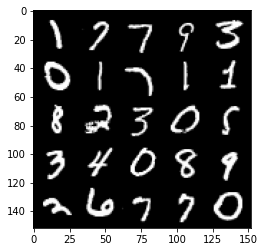

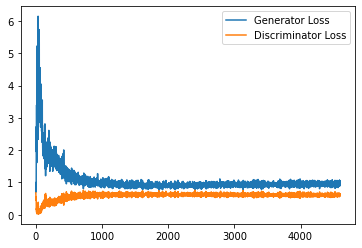

Step 92500: Generator loss: 0.9366976051330567, discriminator loss: 0.6103824073672295


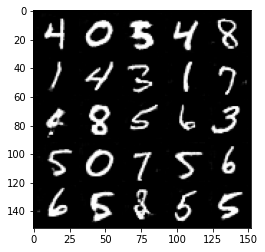

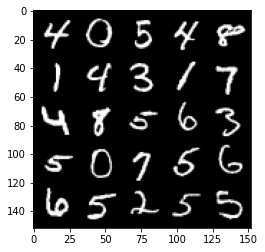

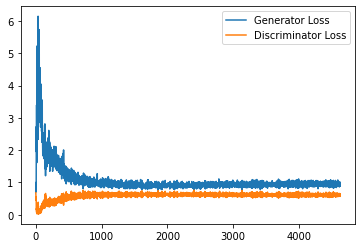

Step 93000: Generator loss: 0.9599989352226257, discriminator loss: 0.6118163588047028


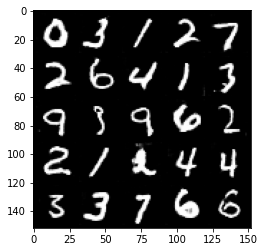

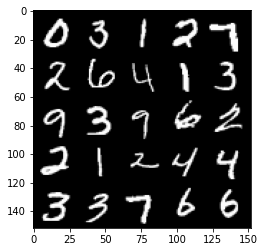

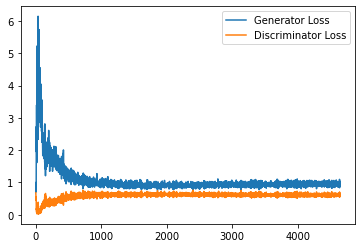

Step 93500: Generator loss: 0.9463484164476395, discriminator loss: 0.6131579015254974


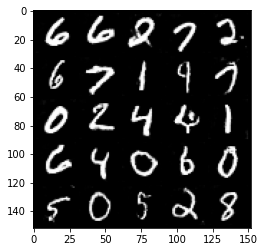

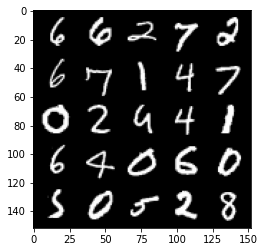

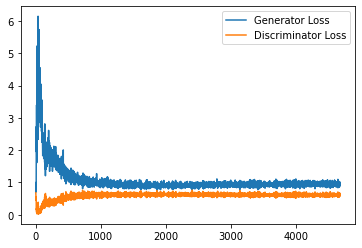

In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()